<a href="https://colab.research.google.com/github/enerhy/Portfolio/blob/master/Rooftop's_surface_decomposition.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Intro

**Task:** The task is to automatically segment rooftops into their respective surface parts. 

  **Data:** Orthophotos from 3 cities with 596 image tiles each containing null, one or several buildings. Each image tile has a binary label image, where 0 is non-rooftop edge 1 is an edge. 

  **Approach:**


*   Suppervised Deep Learning approach with Unet architecture with a VGG16 encoder with ImageNet pretrained weights, decoding via transposed convolutions
*   Adam Optimizer, 
* Exponential restart learning rate 
*   Combination of class weighted Dice and CrossEntropy Loss in 3:1 proportion

**Some techniques used**

*   Use of tf.data pipeline 
* Use of performance optimization techniques such as data caching, data prefetching, data batching, parallelizing and TensorFlow graph operations
*   Low level Training and evaluation code using tf.GradientTape()
*   Application of custom Learning Rate Scheduler
*   Application of custom Unet Architecture
*   Application of custom Losses and Metrics
*   Visualization with Tensorboard









Example Input Image / True Mask / Predictied Mask on Training Images

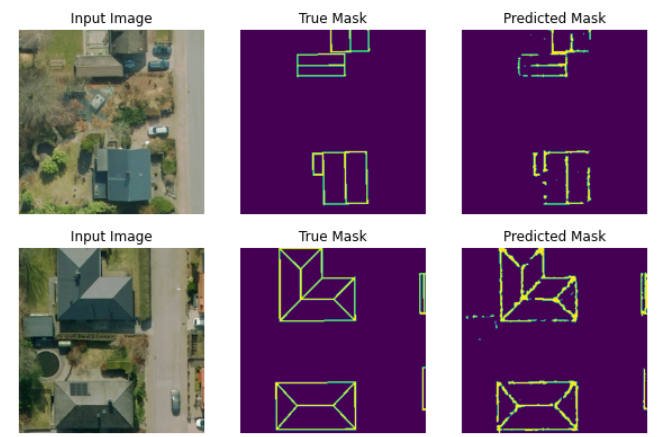

In [ ]:
from IPython.display import Image
Image('/content/drive/MyDrive/Colab Notebooks/Rooftop_segmentation/sample_images/prediction_example.PNG')

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# It is important to place the data into the system path since loading images
# from drive is very slow
from zipfile import ZipFile
file_name = '/content/drive/MyDrive/Colab Notebooks/Rooftop_segmentation/data.zip'

with ZipFile(file_name, 'r') as zip_file:
  zip_file.extractall()
  print('Done')

Done


In [ ]:
"""Prevent Colab for inactivity shutdown"""

# https://stackoverflow.com/questions/57113226/how-to-prevent-google-colab-from-disconnecting

# Ctrl+Shift+I 

# function ClickConnect(){
#     console.log("Clicked on connect button"); 
#     document.querySelector("colab-connect-button").click()
# }
# setInterval(ClickConnect,60000)




'Prevent Colab for inactivity shutdown'

In [ ]:
import os
import numpy as np
import tensorflow as tf
import pandas as pd

####  TF allow MEM GROWTH
# config = tf.compat.v1.ConfigProto()
# config.gpu_options.allow_growth = True
# sess = tf.compat.v1.Session(config=config)

# Folder operations
from glob import glob
import functools

# Visualization
import matplotlib.pyplot as plt

import time

In [ ]:
# !jupyter nbextensions_configurator enable --user

In [ ]:
# List the paths to train and vaild folder:
train_paht = 'train'
valid_paht = 'valid'

In [ ]:
# Key variables:
batch_size     = 4
num_epochs     = 10
image_size     = [256, 256]
num_channels   = 3
# num_classes    = 2
output_channels = 2
random_seed    = 1

# num_train_imgs  = get_num_images(train_paht)
# num_val_imgs    = get_num_images(valid_paht)

# Utils

## DATA UTILS

In [ ]:
def parse_function(filenames, resize_to=[256, 256]):
    """
    Parse files into input/label image pair.
    :param filenames:   Dict containing the two files (filenames['image'], filenames['label'])
    :param resize_to:   H x W Dimensions to resize the image and label to
    :return:            Input tensor, Label tensor
    """
    img_filename, gt_filename = filenames['image'], filenames['label']

    # Reading the files and returning their content as bytes:
    image_string, gt_string = tf.io.read_file(img_filename), tf.io.read_file(gt_filename)
    # Decoding those into images
    image_decoded = tf.io.decode_jpeg(image_string, channels=3)
    gt_decoded = tf.io.decode_png(gt_string, channels=1)
    
    # Converting image to float:
    image = tf.image.convert_image_dtype(image_decoded, tf.float32)
    gt = tf.cast(gt_decoded, tf.float32) / 255.0
                                  
    # Resizing:
    image = tf.image.resize(image, resize_to)
    gt = tf.image.resize(gt, resize_to, method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
    
    return image, gt

In [ ]:
@tf.function
def augmentation_function(image, gt_image, 
                          crop_min_factor=None, flip_left_right=True, flip_up_down=False,
                          brightness_max_delta=0.15, saturation_max_delta=0.5):
    
    # If we decide to randomly flip or resize/crop the image, the same should be applied to
    # the label one so they still match. Therefore, to simplify the procedure, we stack the
    # two images together along the channel axis, before these random operations:
    do_geometrical_transform = crop_min_factor is not None or flip_left_right or flip_up_down
    if do_geometrical_transform:
        num_image_channels = tf.shape(image)[-1]
        num_gt_channels = tf.shape(gt_image)[-1]
        stacked_images = tf.concat([image, tf.cast(gt_image, dtype=image.dtype)], axis=-1)
        
        # Randomly applied flip:
        if flip_left_right:
            stacked_images = tf.image.random_flip_left_right(stacked_images)
        if flip_up_down:
            stacked_images = tf.image.random_flip_up_down(stacked_images)
    
        # Random cropping:
        if crop_min_factor is not None:
            original_shape = tf.shape(stacked_images)[-3:-1]
            random_scale_factor = tf.random.uniform(
                [], minval=crop_min_factor, maxval=1., dtype=tf.float32)
            crop_shape = tf.cast(tf.cast(original_shape, tf.float32) * random_scale_factor, 
                                 tf.int32)
            if len(stacked_images.shape) == 3: # single image:
                crop_shape = tf.concat(
                    [crop_shape, [num_image_channels + num_gt_channels]], axis=0)
            else:                              # batched images:
                batch_size = tf.shape(stacked_images)[0]
                crop_shape = tf.concat(
                    [[batch_size], crop_shape, [num_image_channels + num_gt_channels]], axis=0)
            stacked_images = tf.image.random_crop(stacked_images, crop_shape)
            
        # The remaining transformations should be applied either differently to the input and GT images
        # (nearest-neighbor resizing for the label image VS interpolated resizing for the image),
        # or only to the input image, not the GT one (color changes, etc.). Therefore, we split them back:
        image = stacked_images[..., :num_image_channels]
        gt_image = tf.cast(stacked_images[..., num_image_channels:], dtype=gt_image.dtype)        
        

    # Random B/S changes:
    need_clipping = False
    if brightness_max_delta is not None:
        image = tf.image.random_brightness(image, max_delta=brightness_max_delta)
        need_clipping = True
    if saturation_max_delta is not None:
        image = tf.image.random_saturation(
            image, lower=1 - saturation_max_delta, upper=1 + saturation_max_delta)
        need_clipping = True
    if need_clipping:
        # Because of the random B/S changes, some pixel values may not be in [0, 1] anymore
        # so we clip them properly.
        image = tf.clip_by_value(image, 0.0, 1.0)
        
    return image, gt_image

In [ ]:
def get_image_mask_pair(list_image_files, list_mask_files):
    assert(len(list_image_files) == len(list_mask_files))
    return sorted(list_image_files), sorted(list_mask_files)

## Visualiztion Utils

In [ ]:
def display(display_list):
    plt.figure(figsize=(10, 10))

    title = ['Input Image', 'True Mask', 'Predicted Mask']

    for i in range(len(display_list)):
        plt.subplot(1, len(display_list), i+1)
        plt.title(title[i])
        plt.imshow(tf.keras.preprocessing.image.array_to_img(display_list[i]))
        plt.axis('off')
    plt.show()

In [ ]:
def create_mask(pred_mask, from_logits=False):
    if from_logits:
        pred_mask = tf.nn.softmax(pred_mask, axis=-1)
#         pred_mask = tf.nn.sigmoid(pred_mask)
    pred_mask = tf.argmax(pred_mask, axis=-1)
    pred_mask = pred_mask[..., tf.newaxis]
    return pred_mask

In [ ]:
#  # Variant 2
# def create_mask(pred_mask):
#     pred_new = tf.argmax(pred_mask, axis=-1)
#     pred_new = tf.expand_dims(pred_new, -1)
#     pred_new = tf.cast(pred_new, dtype=tf.float32)
#     return pred_new

In [ ]:
def show_predictions(dataset=None, num=1):
    """
    get rid of hardcoded model name
    """
    for image, mask in dataset.take(num):
        pred_mask = model.predict(image)
        for i in range(pred_mask.shape[0]):
            display([image[i], mask[i], create_mask(pred_mask[i], from_logits=True)])

# Data Preparation

In [ ]:
# Training Dataset

# image files
image_files = glob(train_paht + '/images/*.png')
# mask files
mask_files = glob(train_paht + '/masks/*.png')

num_train_images = len(image_files)
num_train_masks = len(mask_files)
print('number of images: ', num_train_images)
print('number of masks: ', num_train_masks)

train_input_files, train_gt_files = get_image_mask_pair(image_files, mask_files)

image_files = tf.constant([train_input_files[:]])
gt_files = tf.constant([train_gt_files[:]])

dataset_file = tf.data.Dataset.from_tensor_slices({'image': tf.squeeze(image_files), 
                                                   'label': tf.squeeze(gt_files)})

'''Is the repeat() needed?'''
# dataset_file = dataset_file.repeat()
# print(dataset_file)

parse_fn = functools.partial(parse_function, resize_to=image_size)
dataset_image = dataset_file.map(parse_fn)

aug_fn = functools.partial(augmentation_function, crop_min_factor=1, flip_left_right=True, flip_up_down=True,
                          brightness_max_delta=.2, saturation_max_delta=.5)
dataset_aug = dataset_image.map(aug_fn)

dataset_aug = dataset_aug.cache()
dataset_aug = dataset_aug.shuffle(buffer_size=500)
dataset_aug = dataset_aug.batch(batch_size)
train_dataset = dataset_aug.prefetch(buffer_size=tf.data.experimental.AUTOTUNE)

print(train_dataset)

number of images:  443
number of masks:  443
<PrefetchDataset shapes: ((None, None, None, 3), (None, None, None, 1)), types: (tf.float32, tf.float32)>


In [ ]:
# Validation Dataset

# image files
image_files = glob(valid_paht + '/images/*.png')
# mask files
mask_files = glob(valid_paht + '/masks/*.png')

num_valid_images = len(image_files)
num_valid_masks = len(mask_files)
print('number of images: ', num_valid_images)
print('number of masks: ', num_valid_masks)

train_input_files, train_gt_files = get_image_mask_pair(image_files, mask_files)

image_files = tf.constant([train_input_files[:]])
gt_files = tf.constant([train_gt_files[:]])

dataset_file = tf.data.Dataset.from_tensor_slices({'image': tf.squeeze(image_files), 
                                                   'label': tf.squeeze(gt_files)})

parse_fn = functools.partial(parse_function, resize_to=image_size)
valid_dataset = dataset_file.map(parse_fn)
valid_dataset = valid_dataset.batch(batch_size)

print(valid_dataset)

number of images:  153
number of masks:  153
<BatchDataset shapes: ((None, 256, 256, 3), (None, 256, 256, 1)), types: (tf.float32, tf.float32)>


# Look at some samples

## Training Images

(256, 256, 1)


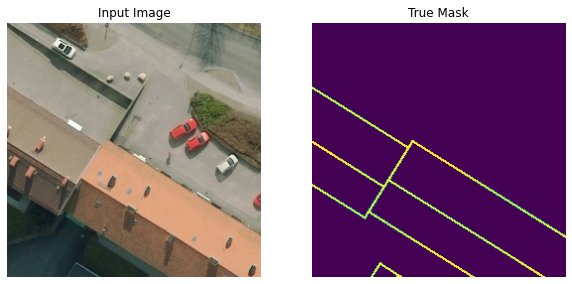

(256, 256, 1)


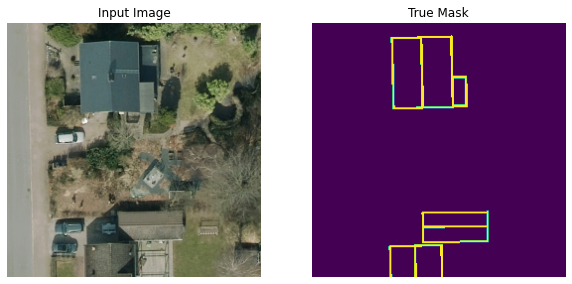

(256, 256, 1)


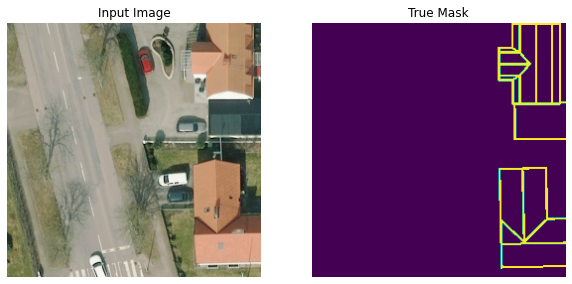

(256, 256, 1)


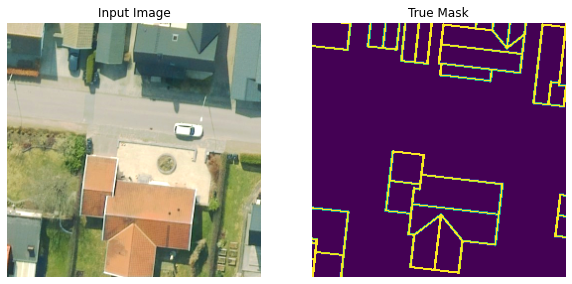

In [ ]:
for image, mask in train_dataset.take(1):
    for i in range(batch_size):
        sample_image, sample_mask = image[i], mask[i]
        print(sample_mask.shape)
        sample_mask
        display([sample_image, sample_mask])

## Validation Images

(256, 256, 1)


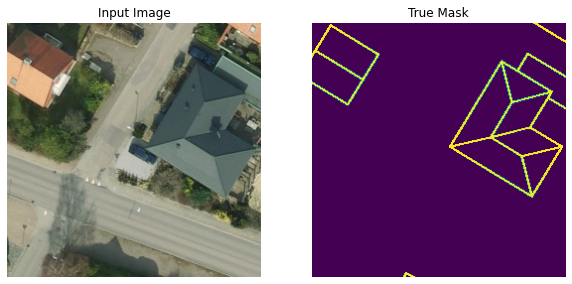

(256, 256, 1)


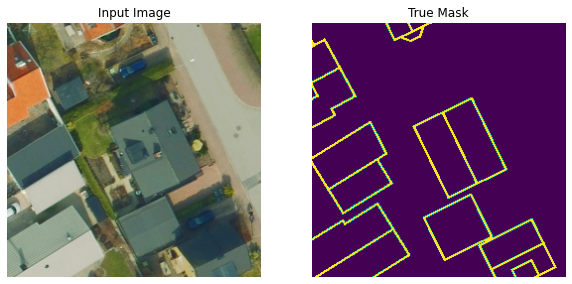

(256, 256, 1)


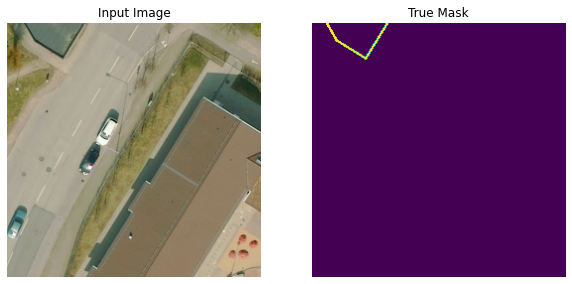

(256, 256, 1)


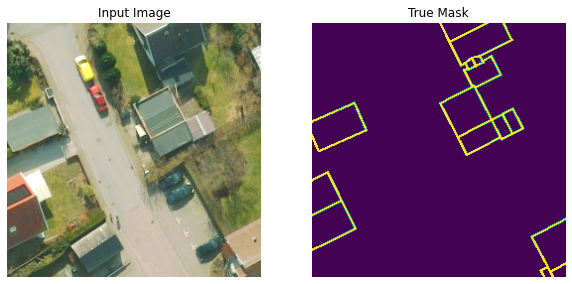

In [ ]:
for image, mask in train_dataset.take(1):
    for i in range(batch_size):
        sample_image, sample_mask = image[i], mask[i]
        print(sample_mask.shape)
        sample_mask
        display([sample_image, sample_mask])

# Building a Unet with pretrained weights

## Build the architecture

In [ ]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import *
from tensorflow.keras.applications.vgg16 import *

In [ ]:
ch_in = 3
inputs = Input(shape=(*image_size, ch_in), name='input')
vgg16 = VGG16(include_top=False, weights='imagenet', input_tensor=inputs)
vgg16.summary()

58892288/58889256 [==============================] - 1s 0us/step
Model: "vgg16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           [(None, 256, 256, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 256, 256, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 256, 256, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 128, 128, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 128, 128, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 128, 128, 128)     147584    
______________________________________________________________

In [ ]:
# Use the activations of these layers
layer_names = [
    'block1_conv2',   # 256x256
    'block2_conv2',   # 128x128
    'block3_conv3',   # 64x64
    'block4_conv3',  # 32x32
    'block5_conv3',      # 16x16
]
layers = [vgg16.get_layer(name).output for name in layer_names]

# Create the feature extraction model
down_stack = tf.keras.Model(inputs=vgg16.input, outputs=layers)

down_stack.trainable = False

In [ ]:
down_stack.outputs

[<KerasTensor: shape=(None, 256, 256, 64) dtype=float32 (created by layer 'block1_conv2')>,
 <KerasTensor: shape=(None, 128, 128, 128) dtype=float32 (created by layer 'block2_conv2')>,
 <KerasTensor: shape=(None, 64, 64, 256) dtype=float32 (created by layer 'block3_conv3')>,
 <KerasTensor: shape=(None, 32, 32, 512) dtype=float32 (created by layer 'block4_conv3')>,
 <KerasTensor: shape=(None, 16, 16, 512) dtype=float32 (created by layer 'block5_conv3')>]

In [ ]:
def upsample(filters, size, norm_type='batchnorm', apply_dropout=False):
    """Upsamples an input.
    Conv2DTranspose => Batchnorm => Dropout => Relu
    Args:
    filters: number of filters
    size: filter size
    norm_type: Normalization type; either 'batchnorm' or 'instancenorm'.
    apply_dropout: If True, adds the dropout layer
    Returns:
    Upsample Sequential Model
    """

    initializer = tf.random_normal_initializer(0., 0.02)

    result = tf.keras.Sequential()
    result.add(
        tf.keras.layers.Conv2DTranspose(filters, size, strides=2,
                                      padding='same',
                                      kernel_initializer=initializer,
                                      use_bias=False))

    if norm_type.lower() == 'batchnorm':
        result.add(tf.keras.layers.BatchNormalization())
    elif norm_type.lower() == 'instancenorm':
        result.add(InstanceNormalization())

    if apply_dropout:
        result.add(tf.keras.layers.Dropout(0.5))

    result.add(tf.keras.layers.ReLU())

    return result



    """
    In Solaris XD_XD is as follow:

    Upsampling followed by two Conv2d layers with ReLU
    def __init__(self, in_channels, middle_channels, out_channels):
        super(XDXD_SN4_DecoderBlock, self).__init__()
        self.in_channels = in_channels
        self.block = nn.Sequential(
            nn.Upsample(scale_factor=2, mode='bilinear'),
            XDXD_SN4_ConvRelu(in_channels, middle_channels),
            XDXD_SN4_ConvRelu(middle_channels, out_channels),
            )

    """

In [ ]:
up_stack = [
    upsample(512, 3),   # 16x16 -> 32x32
    upsample(256, 3),  # 32x32 -> 64x64
    upsample(128, 3),  # 64x64 -> 128x128
    upsample(64, 3),   # 128x128 -> 256x256
]

In [ ]:
def unet_model():
    inputs =  tf.keras.layers.Input(shape=[256, 256, 3])
    x = inputs
    skips = down_stack(x)
    
    x = skips[-1]         # we take output from the first layer (BSx8x8x320)
    
    skips = reversed(skips[:-1])
    
    # Upsampling and establishing the skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x) # we upscale the last layer chosen from the encoder and concat with the next layer chosen
        concat = tf.keras.layers.Concatenate()
        x = concat([x, skip])
        
#     # This is the implementation in TF Tutorials
#     # This is the last layer of the model
#     last = tf.keras.layers.Conv2DTranspose(
#       output_channels, 3, strides=2,
#       padding='same') # Last Upscale but without batchnorm or dropout and no activation

    # This is the implementation in Solaris XD_XD
    second_to_last = tf.keras.layers.Conv2D(filters=32, kernel_size=3, padding='same', activation='relu')
    last = tf.keras.layers.Conv2D(filters=output_channels, kernel_size=1, padding='same')
    
    x = last(second_to_last(x))
    
    return tf.keras.Model(inputs=inputs, outputs=x)
#     return CustomModel(inputs=inputs, outputs=x)

In [ ]:
model = unet_model()

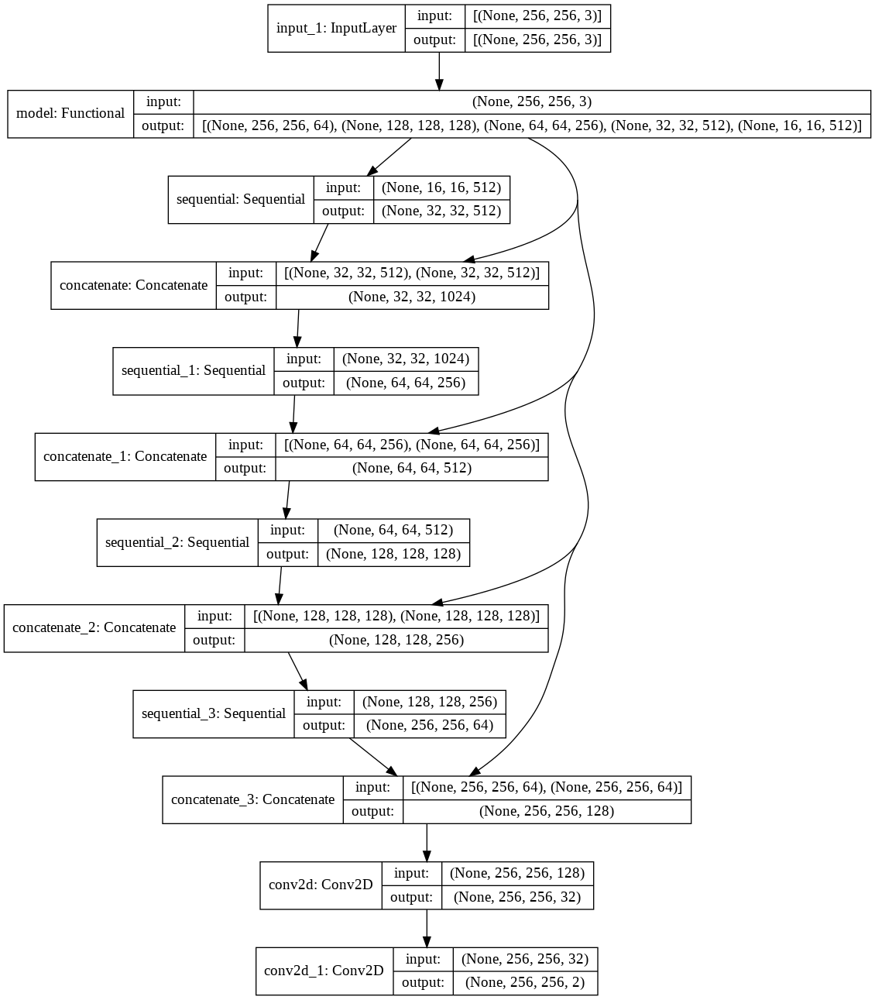

In [ ]:
tf.keras.utils.plot_model(model, show_shapes=True)

# Losses

In [ ]:
# Try 1

# @tf.function
# def dice_loss(y_true, y_pred, eps=1e-6, from_logits=False): #, spatial_axes=[1, 2]
#     num_classes = y_pred.shape[-1]
    
#     if from_logits:
#         y_pred = tf.nn.softmax(y_pred, axis=-1)
#     y_true_onehot  = tf.one_hot(y_true, num_classes, dtype=y_pred.dtype)
    
    
#     # Compute Dice numerator and denominator:
#     num_perclass = 2 * tf.reduce_sum(y_pred * y_true_onehot) #, axis=spatial_axes)
#     den_perclass = tf.reduce_sum(y_pred + y_true_onehot) #, axis=spatial_axes)

#     # Compute Dice and average over batch and classes:
#     dice = tf.reduce_mean((num_perclass + eps) / (den_perclass + eps))

#     return 1 - dice

In [ ]:
# y_pred = tf.nn.softmax(pred_mask, axis=-1)
# y_true = tf.squeeze(tf.cast(mask, tf.int32), axis=-1)
# y_true_onehot = tf.one_hot(y_true, 2, dtype=y_pred.dtype)

# eps = 1e-6
# spatial_axes = [1, 2]
# num_perclass = 2 * tf.reduce_sum(y_pred * y_true_onehot, axis=spatial_axes)
# den_perclass = tf.reduce_sum(y_pred + y_true_onehot, axis=spatial_axes)

# dice = tf.reduce_mean((num_perclass + eps) / (den_perclass + eps))

# 1 - dice

[Info regarding Dice and Soft Dice](https://www.jeremyjordan.me/semantic-segmentation/)

In [ ]:
@tf.function
def dice_loss(y_true, y_pred, eps=1e-6, from_logits=False, spatial_axes=[1, 2]):
    num_classes = y_pred.shape[-1]
    
    if from_logits:
        y_pred = tf.nn.softmax(y_pred, axis=-1)
#         y_pred = tf.nn.sigmoid(y_pred)
        
    y_true = tf.squeeze(tf.cast(y_true, tf.int32), axis=-1)
    y_true_onehot = tf.one_hot(y_true, 2, dtype=y_pred.dtype)
    
    
    # Compute Dice numerator and denominator:
    num_perclass = 2 * tf.reduce_sum(y_pred * y_true_onehot, axis=spatial_axes)
    den_perclass = tf.reduce_sum(y_pred + y_true_onehot, axis=spatial_axes)

    # Compute Dice and average over batch and classes:
    dice = tf.reduce_mean((num_perclass + eps) / (den_perclass + eps))

    return 1 - dice

In [ ]:
@tf.function
def weighted_dice_loss(y_true, y_pred, class_wegihts=[1., 1.], eps=1e-6, from_logits=False, spatial_axes=[1, 2]):
    num_classes = y_pred.shape[-1]
    
    if from_logits:
        y_pred = tf.nn.softmax(y_pred, axis=-1)
#         y_pred = tf.nn.sigmoid(y_pred)
        
    y_true = tf.squeeze(tf.cast(y_true, tf.int32), axis=-1)
    y_true_onehot = tf.one_hot(y_true, 2, dtype=y_pred.dtype)
    
    
    # Compute Dice numerator and denominator:
    num_perclass = 2 * tf.reduce_sum(y_pred * y_true_onehot, axis=spatial_axes)
    den_perclass = tf.reduce_sum(y_pred + y_true_onehot, axis=spatial_axes)
    
    loss_per_channel = (1 - (num_perclass + eps) /(den_perclass + eps)) * class_wegihts

    # Compute Dice and average over batch and classes:
    dice = tf.reduce_mean(loss_per_channel)

    return dice

In [ ]:
class DiceLoss(tf.losses.Loss):
    def __init__(self, eps=1e-6, from_logits=False, class_wegihts=[1., 1.], name='Dice_Loss', spatial_axes=[1, 2]):
        """
        Initialize the loss.
        :param ignore_value:  trainID value of ignored classes (`None` if ignored none) 
        :param eps:           Epsilon small value (smooth) 
        :param spatial_axes:  Spatial axes
        :param from_logits:   Flag if predictions are logits (not normalized)
        :param name:          Name
        """
        super().__init__(name=name)
        self.eps = eps
        self.spatial_axes = spatial_axes
        self.from_logits = from_logits
        self.class_wegihts = class_wegihts
    
    def __call__(self, y_true, y_pred, sample_weight=None):
        """
        Compute the Dice loss for semantic segmentation, ignoring pixels from some misc. classes.
        :param y_true:        Ground-truth label map(s) (e.g., of shape B x H x W)
        :param y_pred:        Predicted logit map(s) () (e.g., of shape B x H x W x N, N number of classes)
        :param sample_weight: opt. weight tensor, broadcastable to `y_true`
        :return:              Loss value
        """
        return weighted_dice_loss(y_true, y_pred, class_wegihts=self.class_wegihts, eps=self.eps, from_logits=self.from_logits, spatial_axes=self.spatial_axes) 

https://lars76.github.io/2018/09/27/loss-functions-for-segmentation.html

In [ ]:
# bce = tf.keras.losses.BinaryCrossentropy(
#     from_logits=False, name='binary_crossentropy'
# )

# Eval Metrics

In [ ]:
# MIOU v1
class MIoU3(tf.keras.metrics.Metric):
    def __init__(self, num_classes, name='mIOU_Angel', **kwargs):
        super(MIoU3, self).__init__(name=name, **kwargs)
        self.eps = 1e-8
        self.num_classes = num_classes
        
        self.total_cm = self.add_weight(name="total_confusion_matrix", shape=(num_classes, num_classes), initializer='zeros')
        
    def reset_states(self):
        for s in self.variables:
            s.assign(tf.zeros(shape=s.shape))
            
    def update_state(self, y_true, y_pred, sample_weight=None):
        self.total_cm.assign_add(self.confusion_matrix(y_true, y_pred))
        return self.total_cm
    
    def result(self):
        return self.mIOU()
    
    
    
    def confusion_matrix(self, y_true, y_pred):
        label = tf.argmax(y_pred, axis=-1)

        gt_image = tf.squeeze(y_true, -1)
        mask_cm = (gt_image >= 0) & (gt_image < self.num_classes)

        label = self.num_classes * tf.cast(gt_image[mask_cm], tf.int8) + tf.cast(label[mask_cm], tf.int8)
        count = np.bincount(label, minlength=self.num_classes*self.num_classes)

        cm = count.reshape(self.num_classes, self.num_classes)
        
        return cm
    
    def mIOU(self):
#         miou = np.diag(self.total_cm) / (np.sum(self.total_cm, axis=1) + np.sum(self.total_cm, axis=0) - (np.diag(self.total_cm) + eps))
#         miou = np.nanmean(miou)
#         return miou
#         return print(self.total_cm.numpy()), print(np.diag(self.total_cm.numpy()))

        miou = np.diag(self.total_cm.numpy()) / (np.sum(self.total_cm.numpy(), axis=1) + np.sum(self.total_cm.numpy(), axis=0) - (np.diag(self.total_cm.numpy()) + self.eps))
        miou = np.nanmean(miou)
        return miou



In [ ]:
# # MIOU v2
# def mio_test(gt_mask, pred_mask):
#     num_classes = 2
#     eps = 1e-8
#     label = tf.argmax(pred_mask, axis=-1)

#     gt_image = tf.squeeze(gt_mask, -1)
#     mask_cm = (gt_image >= 0) & (gt_image < num_classes)

#     label = num_classes * tf.cast(gt_image[mask_cm], tf.int8) + tf.cast(label[mask_cm], tf.int8)
#     count = np.bincount(label, minlength=num_classes ** 2)

#     confusion_matrix = count.reshape(num_classes, num_classes)
    
#     MIoU = np.diag(confusion_matrix) / (np.sum(confusion_matrix, axis=1) + np.sum(confusion_matrix, axis=0) - (np.diag(confusion_matrix) + eps))
#     MIoU = np.nanmean(MIoU)

#     return MIoU

# Learning Rate Scheduler

In [ ]:
import math

class ExpRestartCosineAnnealingLR(tf.keras.optimizers.schedules.LearningRateSchedule):
    def __init__(self, initial_lr, T_max, lr_div, C_mult=1, eta_min=0, last_epoch=-1, warmup = 0):
        self.T_max = T_max
        self.eta_min = eta_min
        self.C_mult = C_mult
        self.counter = 0
        self.lr_div = lr_div
        self.warmup = warmup
        self.initial_lr = initial_lr

    def __call__(self, step):
        # calcolo valore

        if self.counter < self.warmup:
            v = self.initial_lr / 100
        else:
            self.warmup = -1
            # la prima meta' e' normale
            pos = self.counter % (2 * self.T_max)
            v = 1
            if (pos < self.T_max):
                v = self.eta_min + (self.initial_lr - self.eta_min) * (1 + math.cos(math.pi * pos / self.T_max)) / 2
            else:
            # la seconda meta' e' invertita
                v = self.eta_min + (self.initial_lr - self.eta_min) * (1 - math.cos(math.pi * pos / self.T_max)) / 2

        self.counter += 1
        if self.counter >= self.T_max:
            # moltiplico per il ciclo
            self.counter = 0
            self.T_max = int(self.C_mult * self.T_max)
            # diminuisco la base
            self.initial_lr = self.eta_min + (self.initial_lr - self.eta_min) / self.lr_div

        return v

In [ ]:
init_lr=3*1e-2

lr_scheduler = ExpRestartCosineAnnealingLR(
                            initial_lr=init_lr,
                            T_max=int(num_train_images / batch_size),
                            lr_div = 1.2, C_mult = 2,
                            eta_min = init_lr / 130.0, warmup = 80)

# Callbacks only to use with fit API


In [ ]:
# from IPython.display import clear_output
# class DisplayCallback(tf.keras.callbacks.Callback):
#     def on_epoch_end(self, epoch, logs=None):
#         clear_output(wait=True)
#         show_predictions(train_dataset) # The dataset on which we are checking 
#                                    # the predictions
#         print ('\nSample Prediction after epoch {}\n'.format(epoch+1))

In [ ]:
# from tensorflow.keras.callbacks import ModelCheckpoint
# filepath="checkpoint/weights-improvement-{epoch:02d}-{loss:.2f}.hdf5" # .ckpt
# mc = ModelCheckpoint(filepath=filepath, monitor='loss', mode='min', verbose=1, save_best_only=True, save_freq='epoch')

In [ ]:
# from tensorflow.keras.callbacks import CSVLogger
# csv_logger = CSVLogger('training.log', append=True, separator=',')

In [ ]:
# callbacks = [DisplayCallback(),
# #             csv_logger,
# #             mc,
# #             tf.keras.callbacks.TensorBoard(log_dir='logs', histogram_freq=0, write_graph=False)
#             ]

# Tensorboard Visualization

In [ ]:
# TODO: Log-Files updated with versions / dates

log_folder = '/content/drive/MyDrive/Colab Notebooks/Rooftop_segmentation/'
# tb_folder = log_folder + "summaries/v03"
tb_folder = 'simple_logs'
model_path = log_folder + "model_v01.h5"

In [ ]:
# !mkdir '/content/drive/MyDrive/Colab Notebooks/Rooftop_segmentation/summaries/v04'
!mkdir 'simple_logs'

In [ ]:
# Load the TensorBoard notebook extension
%load_ext tensorboard

In [ ]:
%tensorboard --logdir "/content/drive/MyDrive/Colab Notebooks/Rooftop_segmentation/copied_log"

<IPython.core.display.Javascript object>

# Train

In [ ]:
import math

# Number of batches per train/val epoch, to guide the Keras `fit` method:
train_steps_per_epoch = math.ceil(num_train_images / batch_size)
val_steps_per_epoch   = math.ceil(num_valid_images / batch_size)

## Train with custom loop

In [ ]:
class_wegihts = [1., 10.] # Class weight implemented only for the Dice Loss

optimizer = tf.keras.optimizers.Adam(init_lr)
loss_fn_1 = DiceLoss(from_logits=True, class_wegihts=class_wegihts)
loss_fn_2 = tf.keras.losses.SparseCategoricalCrossentropy(
    from_logits=True, name='categorical_crossentropy')

loss_weight = [3, 1]

# metric_1 = tf.keras.metrics.Accuracy()
metric_2_train = MIoU3(num_classes=2)
metric_2_valid = MIoU3(num_classes=2)

In [ ]:
@tf.function
def train_step(x_batch_train, y_batch_train):
    with tf.GradientTape() as tape:
        pred_mask = model(x_batch_train, training=True) 
        # Compute the loss value for this minibatch.
        loss_value_1 = loss_fn_1(y_batch_train, pred_mask)
        loss_value_2 = loss_fn_2(y_batch_train, pred_mask)
        
        loss = loss_value_1*loss_weight[0] + loss_value_2*loss_weight[1]

        grads = tape.gradient(loss, model.trainable_weights)
        optimizer.apply_gradients(zip(grads, model.trainable_weights))      

    return loss, loss_value_1, loss_value_2, pred_mask

In [ ]:
@tf.function
def valid_step(x_batch_val, y_batch_val):
    pred_masks = model(x_batch_val, training=False)
    # Compute the loss value for this minibatch.
    loss_value_1 = loss_fn_1(y_batch_val, pred_masks)
    loss_value_2 = loss_fn_2(y_batch_val, pred_masks)

    loss = loss_value_1*loss_weight[0] + loss_value_2*loss_weight[1]      

    return loss, loss_value_1, loss_value_2, pred_masks


Start of epoch 0
Current learning rage 0.030000
Training loss (for one batch) at step 0: 16.9547
Dice_Loss (for one batch) at step 0: 5.0616
categorical_crossentropy (for one batch) at step 0: 1.7699
Seen so far: 4 samples

Current learning rage 0.000300
Training loss (for one batch) at step 10: 18.2353
Dice_Loss (for one batch) at step 10: 5.0057
categorical_crossentropy (for one batch) at step 10: 3.2183
Seen so far: 44 samples

Current learning rage 0.000300
Training loss (for one batch) at step 20: 15.3210
Dice_Loss (for one batch) at step 20: 3.7577
categorical_crossentropy (for one batch) at step 20: 4.0478
Seen so far: 84 samples

Current learning rage 0.000300
Training loss (for one batch) at step 30: 18.9137
Dice_Loss (for one batch) at step 30: 5.0081
categorical_crossentropy (for one batch) at step 30: 3.8894
Seen so far: 124 samples

Current learning rage 0.000300
Training loss (for one batch) at step 40: 19.8597
Dice_Loss (for one batch) at step 40: 5.0111
categorical_cro

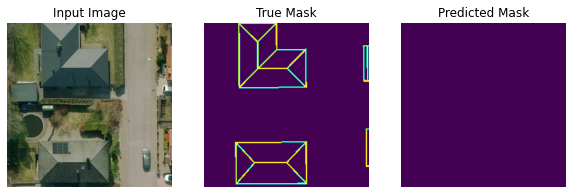

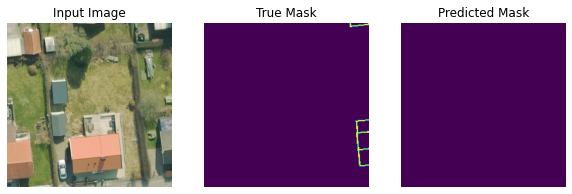

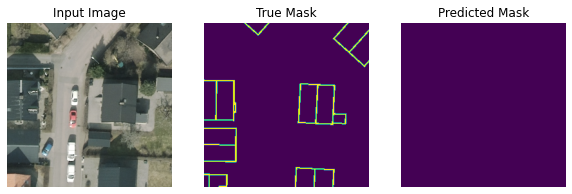

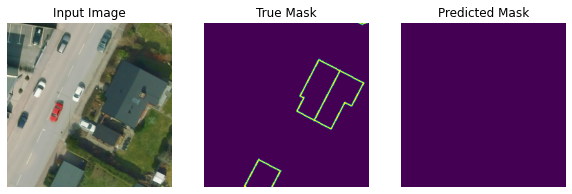

Validation MIoU: 0.4846
Epoch 0: Validation Dice_Loss : 4.7284
Epoch 0: Validation categorical_crossentropy : 0.1738
Time taken: 65.51s

Start of epoch 1
Current learning rage 0.025038
Training loss (for one batch) at step 0: 14.4172
Dice_Loss (for one batch) at step 0: 4.7338
categorical_crossentropy (for one batch) at step 0: 0.2157
Seen so far: 4 samples

Current learning rage 0.024912
Training loss (for one batch) at step 10: 14.8339
Dice_Loss (for one batch) at step 10: 4.8447
categorical_crossentropy (for one batch) at step 10: 0.2998
Seen so far: 44 samples

Current learning rage 0.024536
Training loss (for one batch) at step 20: 12.6677
Dice_Loss (for one batch) at step 20: 4.1434
categorical_crossentropy (for one batch) at step 20: 0.2375
Seen so far: 84 samples

Current learning rage 0.023918
Training loss (for one batch) at step 30: 12.1474
Dice_Loss (for one batch) at step 30: 3.9059
categorical_crossentropy (for one batch) at step 30: 0.4297
Seen so far: 124 samples

Curre

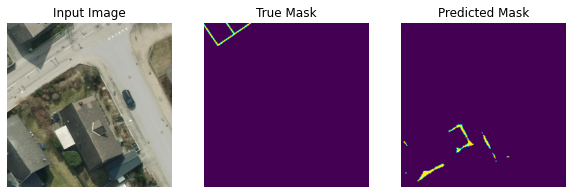

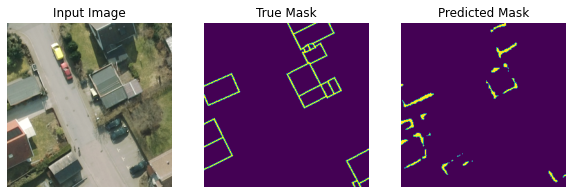

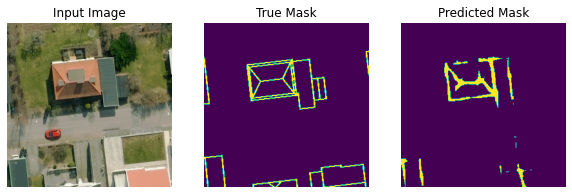

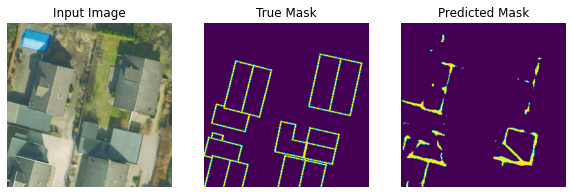

Validation MIoU: 0.5235
Epoch 1: Validation Dice_Loss : 4.4164
Epoch 1: Validation categorical_crossentropy : 0.3723
Time taken: 17.55s

Start of epoch 2
Current learning rage 0.012457
Training loss (for one batch) at step 0: 11.8560
Dice_Loss (for one batch) at step 0: 3.8633
categorical_crossentropy (for one batch) at step 0: 0.2662
Seen so far: 4 samples

Current learning rage 0.010694
Training loss (for one batch) at step 10: 11.6715
Dice_Loss (for one batch) at step 10: 3.8049
categorical_crossentropy (for one batch) at step 10: 0.2567
Seen so far: 44 samples

Current learning rage 0.008970
Training loss (for one batch) at step 20: 11.1406
Dice_Loss (for one batch) at step 20: 3.6360
categorical_crossentropy (for one batch) at step 20: 0.2326
Seen so far: 84 samples

Current learning rage 0.007321
Training loss (for one batch) at step 30: 12.3071
Dice_Loss (for one batch) at step 30: 4.0352
categorical_crossentropy (for one batch) at step 30: 0.2014
Seen so far: 124 samples

Curre

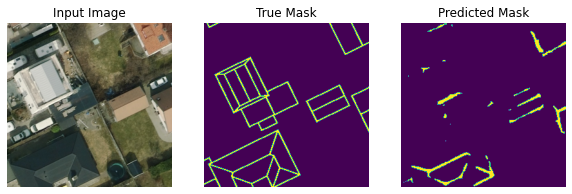

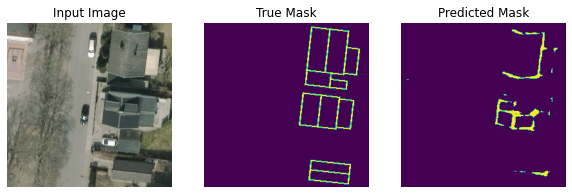

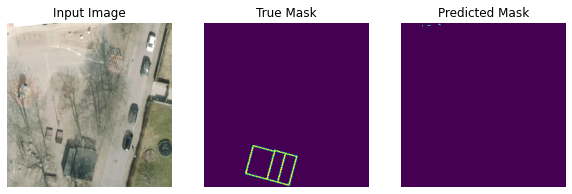

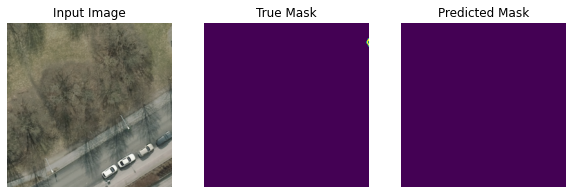

Validation MIoU: 0.5388
Epoch 2: Validation Dice_Loss : 4.1094
Epoch 2: Validation categorical_crossentropy : 0.3098
Time taken: 17.99s

Start of epoch 3
Current learning rage 0.020903
Training loss (for one batch) at step 0: 11.1171
Dice_Loss (for one batch) at step 0: 3.6366
categorical_crossentropy (for one batch) at step 0: 0.2072
Seen so far: 4 samples

Current learning rage 0.020866
Training loss (for one batch) at step 10: 11.7661
Dice_Loss (for one batch) at step 10: 3.8131
categorical_crossentropy (for one batch) at step 10: 0.3267
Seen so far: 44 samples

Current learning rage 0.020777
Training loss (for one batch) at step 20: 11.6581
Dice_Loss (for one batch) at step 20: 3.7567
categorical_crossentropy (for one batch) at step 20: 0.3880
Seen so far: 84 samples

Current learning rage 0.020635
Training loss (for one batch) at step 30: 11.7437
Dice_Loss (for one batch) at step 30: 3.6932
categorical_crossentropy (for one batch) at step 30: 0.6642
Seen so far: 124 samples

Curre

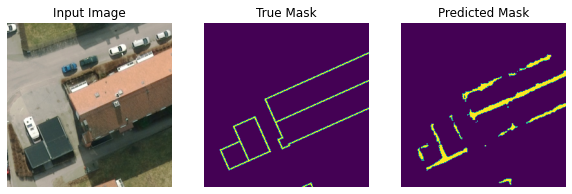

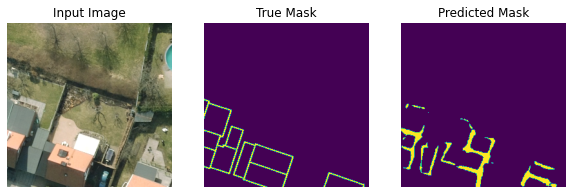

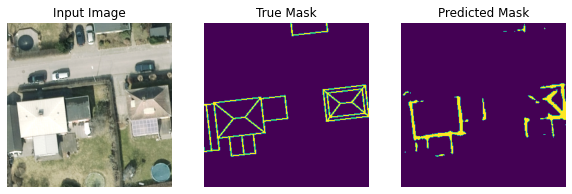

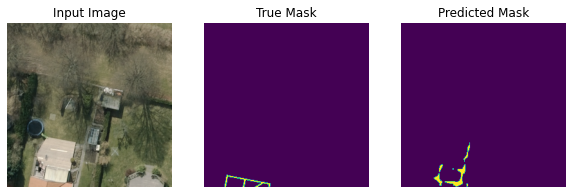

Validation MIoU: 0.5430
Epoch 3: Validation Dice_Loss : 3.9734
Epoch 3: Validation categorical_crossentropy : 0.7014
Time taken: 17.53s

Start of epoch 4
Current learning rage 0.017718
Training loss (for one batch) at step 0: 9.2102
Dice_Loss (for one batch) at step 0: 2.9667
categorical_crossentropy (for one batch) at step 0: 0.3100
Seen so far: 4 samples

Current learning rage 0.017167
Training loss (for one batch) at step 10: 11.7517
Dice_Loss (for one batch) at step 10: 3.7811
categorical_crossentropy (for one batch) at step 10: 0.4083
Seen so far: 44 samples

Current learning rage 0.016583
Training loss (for one batch) at step 20: 11.1609
Dice_Loss (for one batch) at step 20: 3.5654
categorical_crossentropy (for one batch) at step 20: 0.4646
Seen so far: 84 samples

Current learning rage 0.015968
Training loss (for one batch) at step 30: 11.7462
Dice_Loss (for one batch) at step 30: 3.8046
categorical_crossentropy (for one batch) at step 30: 0.3323
Seen so far: 124 samples

Curren

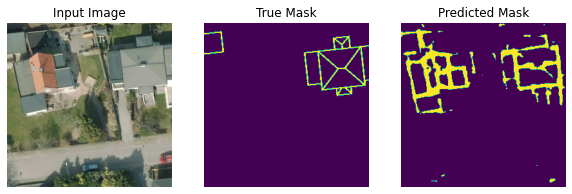

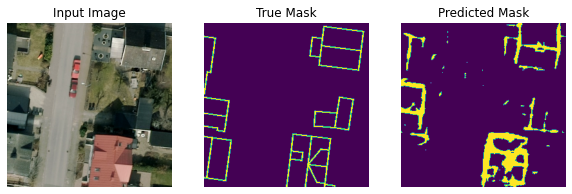

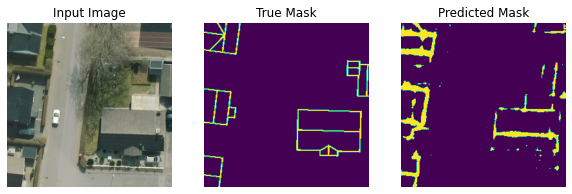

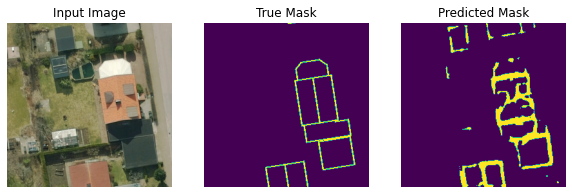

Validation MIoU: 0.5328
Epoch 4: Validation Dice_Loss : 3.8818
Epoch 4: Validation categorical_crossentropy : 0.3438
Time taken: 17.26s

Start of epoch 5
Current learning rage 0.010272
Training loss (for one batch) at step 0: 10.7059
Dice_Loss (for one batch) at step 0: 3.4880
categorical_crossentropy (for one batch) at step 0: 0.2420
Seen so far: 4 samples

Current learning rage 0.009536
Training loss (for one batch) at step 10: 11.0143
Dice_Loss (for one batch) at step 10: 3.5123
categorical_crossentropy (for one batch) at step 10: 0.4775
Seen so far: 44 samples

Current learning rage 0.008805
Training loss (for one batch) at step 20: 11.9849
Dice_Loss (for one batch) at step 20: 3.8927
categorical_crossentropy (for one batch) at step 20: 0.3067
Seen so far: 84 samples

Current learning rage 0.008083
Training loss (for one batch) at step 30: 10.5492
Dice_Loss (for one batch) at step 30: 3.4645
categorical_crossentropy (for one batch) at step 30: 0.1558
Seen so far: 124 samples

Curre

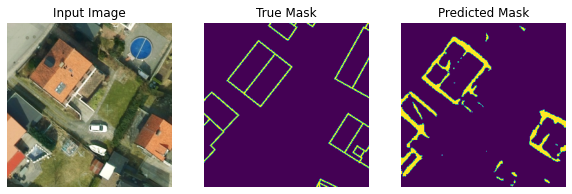

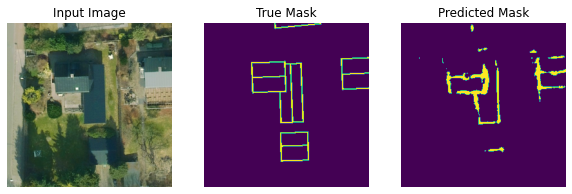

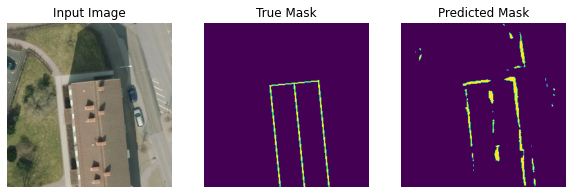

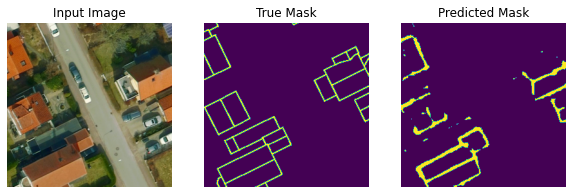

Validation MIoU: 0.5453
Epoch 5: Validation Dice_Loss : 3.8954
Epoch 5: Validation categorical_crossentropy : 0.3108
Time taken: 17.50s

Start of epoch 6
Current learning rage 0.003002
Training loss (for one batch) at step 0: 11.7466
Dice_Loss (for one batch) at step 0: 3.7761
categorical_crossentropy (for one batch) at step 0: 0.4183
Seen so far: 4 samples

Current learning rage 0.002519
Training loss (for one batch) at step 10: 9.5830
Dice_Loss (for one batch) at step 10: 3.1190
categorical_crossentropy (for one batch) at step 10: 0.2260
Seen so far: 44 samples

Current learning rage 0.002077
Training loss (for one batch) at step 20: 10.5061
Dice_Loss (for one batch) at step 20: 3.4234
categorical_crossentropy (for one batch) at step 20: 0.2360
Seen so far: 84 samples

Current learning rage 0.001678
Training loss (for one batch) at step 30: 11.5894
Dice_Loss (for one batch) at step 30: 3.7720
categorical_crossentropy (for one batch) at step 30: 0.2735
Seen so far: 124 samples

Curren

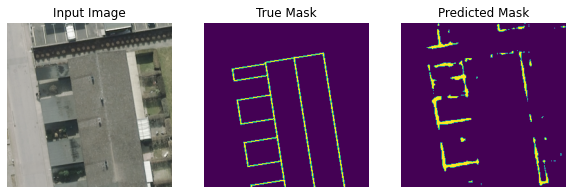

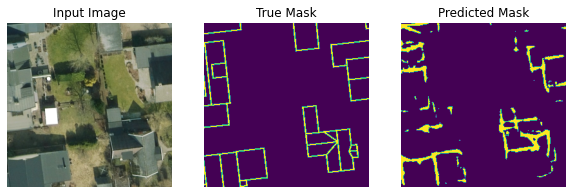

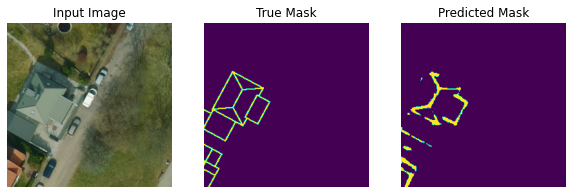

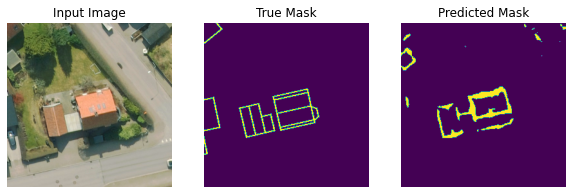

Validation MIoU: 0.5424
Epoch 6: Validation Dice_Loss : 3.8732
Epoch 6: Validation categorical_crossentropy : 0.3264
Time taken: 17.49s

Start of epoch 7
Current learning rage 0.017456
Training loss (for one batch) at step 0: 9.6632
Dice_Loss (for one batch) at step 0: 3.1508
categorical_crossentropy (for one batch) at step 0: 0.2109
Seen so far: 4 samples

Current learning rage 0.017444
Training loss (for one batch) at step 10: 10.1661
Dice_Loss (for one batch) at step 10: 3.2601
categorical_crossentropy (for one batch) at step 10: 0.3859
Seen so far: 44 samples

Current learning rage 0.017421
Training loss (for one batch) at step 20: 12.3185
Dice_Loss (for one batch) at step 20: 4.0520
categorical_crossentropy (for one batch) at step 20: 0.1624
Seen so far: 84 samples

Current learning rage 0.017387
Training loss (for one batch) at step 30: 11.3392
Dice_Loss (for one batch) at step 30: 3.6674
categorical_crossentropy (for one batch) at step 30: 0.3369
Seen so far: 124 samples

Curren

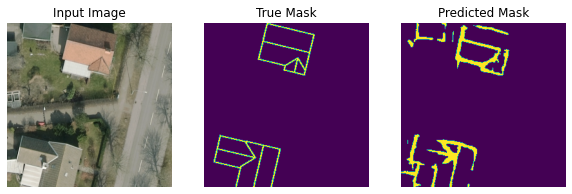

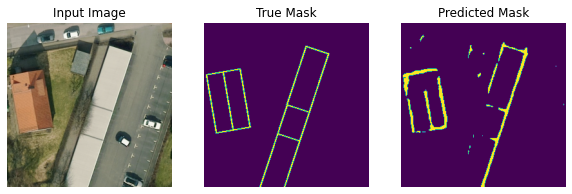

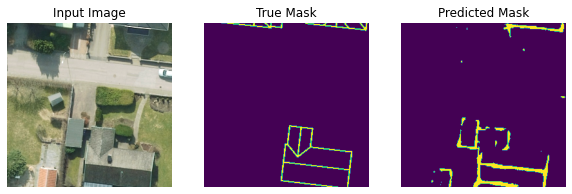

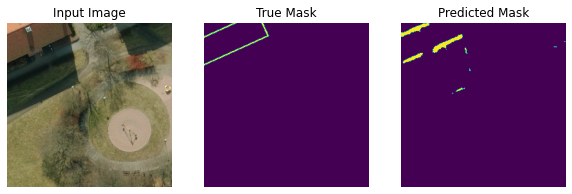

Validation MIoU: 0.5454
Epoch 7: Validation Dice_Loss : 3.8728
Epoch 7: Validation categorical_crossentropy : 0.3358
Time taken: 17.61s

Start of epoch 8
Current learning rage 0.016718
Training loss (for one batch) at step 0: 10.5491
Dice_Loss (for one batch) at step 0: 3.4241
categorical_crossentropy (for one batch) at step 0: 0.2769
Seen so far: 4 samples

Current learning rage 0.016588
Training loss (for one batch) at step 10: 10.5091
Dice_Loss (for one batch) at step 10: 3.4080
categorical_crossentropy (for one batch) at step 10: 0.2851
Seen so far: 44 samples

Current learning rage 0.016448
Training loss (for one batch) at step 20: 10.7528
Dice_Loss (for one batch) at step 20: 3.4632
categorical_crossentropy (for one batch) at step 20: 0.3633
Seen so far: 84 samples

Current learning rage 0.016299
Training loss (for one batch) at step 30: 10.4127
Dice_Loss (for one batch) at step 30: 3.3772
categorical_crossentropy (for one batch) at step 30: 0.2812
Seen so far: 124 samples

Curre

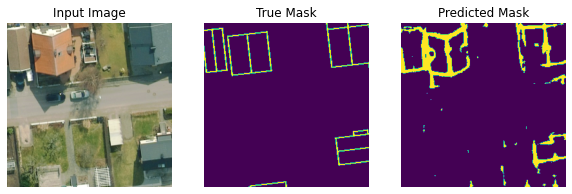

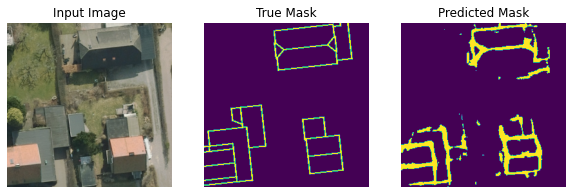

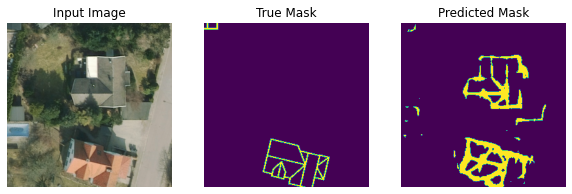

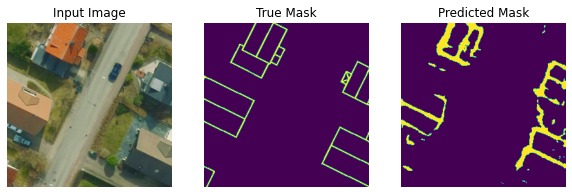

Validation MIoU: 0.5395
Epoch 8: Validation Dice_Loss : 3.8421
Epoch 8: Validation categorical_crossentropy : 0.3868
Time taken: 17.75s

Start of epoch 9
Current learning rage 0.014759
Training loss (for one batch) at step 0: 10.7751
Dice_Loss (for one batch) at step 0: 3.4837
categorical_crossentropy (for one batch) at step 0: 0.3239
Seen so far: 4 samples

Current learning rage 0.014532
Training loss (for one batch) at step 10: 11.1948
Dice_Loss (for one batch) at step 10: 3.6516
categorical_crossentropy (for one batch) at step 10: 0.2399
Seen so far: 44 samples

Current learning rage 0.014297
Training loss (for one batch) at step 20: 11.7550
Dice_Loss (for one batch) at step 20: 3.7820
categorical_crossentropy (for one batch) at step 20: 0.4091
Seen so far: 84 samples

Current learning rage 0.014056
Training loss (for one batch) at step 30: 12.0603
Dice_Loss (for one batch) at step 30: 3.9489
categorical_crossentropy (for one batch) at step 30: 0.2135
Seen so far: 124 samples

Curre

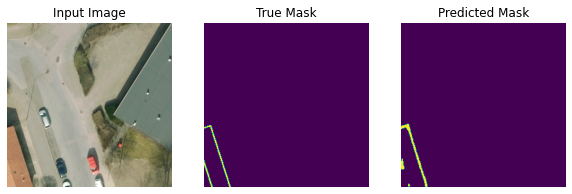

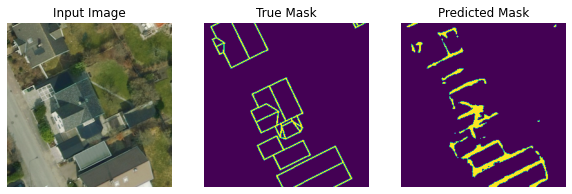

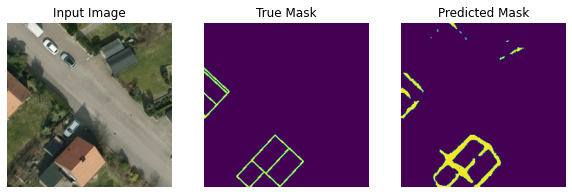

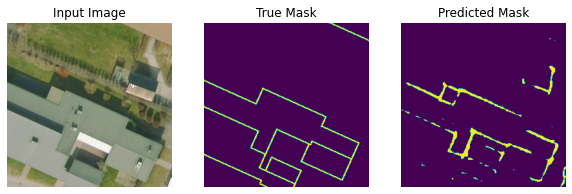

Validation MIoU: 0.5448
Epoch 9: Validation Dice_Loss : 3.9046
Epoch 9: Validation categorical_crossentropy : 0.3405
Time taken: 17.52s

Start of epoch 10
Current learning rage 0.011884
Training loss (for one batch) at step 0: 10.0112
Dice_Loss (for one batch) at step 0: 3.2097
categorical_crossentropy (for one batch) at step 0: 0.3821
Seen so far: 4 samples

Current learning rage 0.011594
Training loss (for one batch) at step 10: 10.8573
Dice_Loss (for one batch) at step 10: 3.5145
categorical_crossentropy (for one batch) at step 10: 0.3138
Seen so far: 44 samples

Current learning rage 0.011301
Training loss (for one batch) at step 20: 10.2427
Dice_Loss (for one batch) at step 20: 3.3256
categorical_crossentropy (for one batch) at step 20: 0.2659
Seen so far: 84 samples

Current learning rage 0.011005
Training loss (for one batch) at step 30: 9.2831
Dice_Loss (for one batch) at step 30: 3.0103
categorical_crossentropy (for one batch) at step 30: 0.2523
Seen so far: 124 samples

Curre

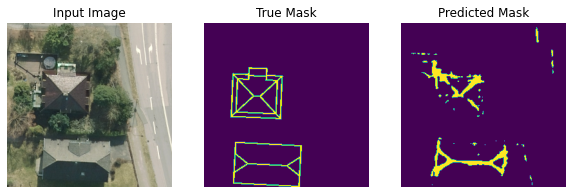

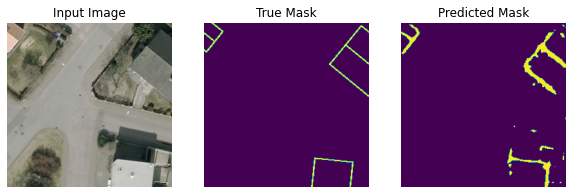

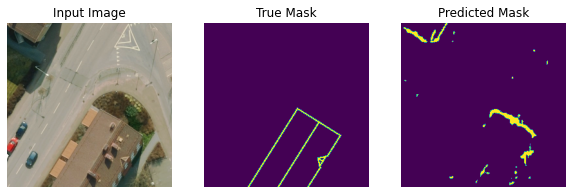

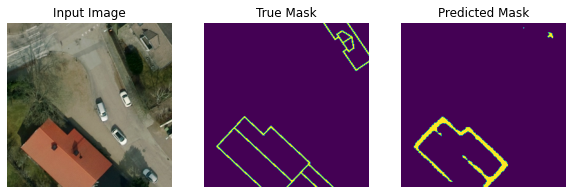

Validation MIoU: 0.5454
Epoch 10: Validation Dice_Loss : 3.8950
Epoch 10: Validation categorical_crossentropy : 0.3440
Time taken: 17.41s

Start of epoch 11
Current learning rage 0.008537
Training loss (for one batch) at step 0: 10.1092
Dice_Loss (for one batch) at step 0: 3.2891
categorical_crossentropy (for one batch) at step 0: 0.2418
Seen so far: 4 samples

Current learning rage 0.008230
Training loss (for one batch) at step 10: 8.7441
Dice_Loss (for one batch) at step 10: 2.8449
categorical_crossentropy (for one batch) at step 10: 0.2093
Seen so far: 44 samples

Current learning rage 0.007924
Training loss (for one batch) at step 20: 10.7363
Dice_Loss (for one batch) at step 20: 3.4542
categorical_crossentropy (for one batch) at step 20: 0.3737
Seen so far: 84 samples

Current learning rage 0.007619
Training loss (for one batch) at step 30: 8.8818
Dice_Loss (for one batch) at step 30: 2.8988
categorical_crossentropy (for one batch) at step 30: 0.1855
Seen so far: 124 samples

Curr

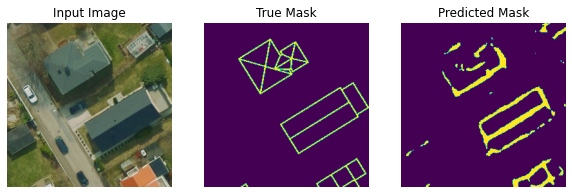

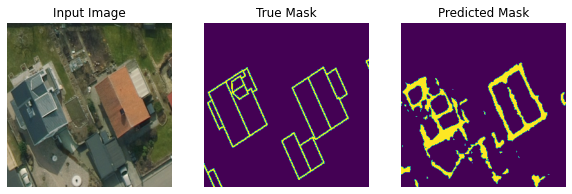

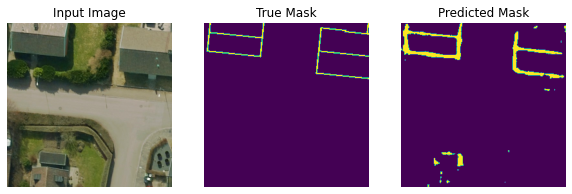

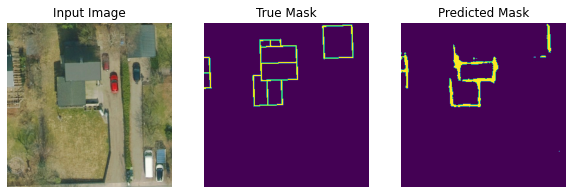

Validation MIoU: 0.5385
Epoch 11: Validation Dice_Loss : 3.8677
Epoch 11: Validation categorical_crossentropy : 0.3596
Time taken: 17.65s

Start of epoch 12
Current learning rage 0.005238
Training loss (for one batch) at step 0: 10.3859
Dice_Loss (for one batch) at step 0: 3.3596
categorical_crossentropy (for one batch) at step 0: 0.3073
Seen so far: 4 samples

Current learning rage 0.004961
Training loss (for one batch) at step 10: 8.9317
Dice_Loss (for one batch) at step 10: 2.8864
categorical_crossentropy (for one batch) at step 10: 0.2725
Seen so far: 44 samples

Current learning rage 0.004689
Training loss (for one batch) at step 20: 10.4217
Dice_Loss (for one batch) at step 20: 3.2969
categorical_crossentropy (for one batch) at step 20: 0.5310
Seen so far: 84 samples

Current learning rage 0.004423
Training loss (for one batch) at step 30: 9.0297
Dice_Loss (for one batch) at step 30: 2.9144
categorical_crossentropy (for one batch) at step 30: 0.2864
Seen so far: 124 samples

Curr

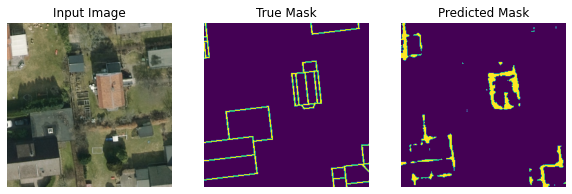

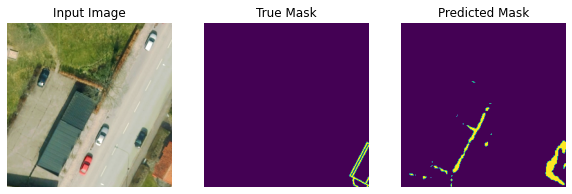

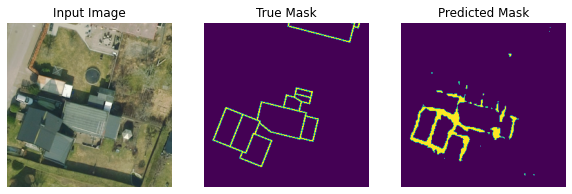

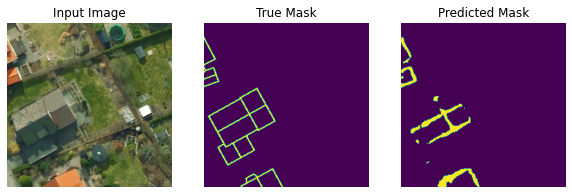

Validation MIoU: 0.5434
Epoch 12: Validation Dice_Loss : 3.8987
Epoch 12: Validation categorical_crossentropy : 0.3584
Time taken: 17.60s

Start of epoch 13
Current learning rage 0.002498
Training loss (for one batch) at step 0: 9.2869
Dice_Loss (for one batch) at step 0: 2.9817
categorical_crossentropy (for one batch) at step 0: 0.3418
Seen so far: 4 samples

Current learning rage 0.002295
Training loss (for one batch) at step 10: 9.9594
Dice_Loss (for one batch) at step 10: 3.2731
categorical_crossentropy (for one batch) at step 10: 0.1401
Seen so far: 44 samples

Current learning rage 0.002099
Training loss (for one batch) at step 20: 10.4269
Dice_Loss (for one batch) at step 20: 3.3321
categorical_crossentropy (for one batch) at step 20: 0.4307
Seen so far: 84 samples

Current learning rage 0.001912
Training loss (for one batch) at step 30: 9.0178
Dice_Loss (for one batch) at step 30: 2.9343
categorical_crossentropy (for one batch) at step 30: 0.2149
Seen so far: 124 samples

Curre

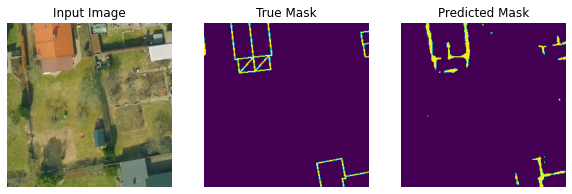

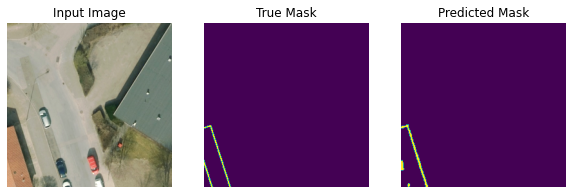

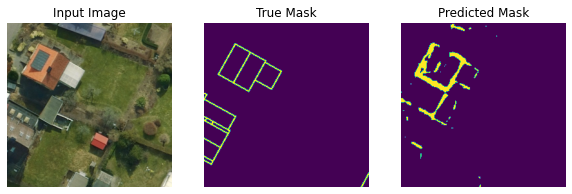

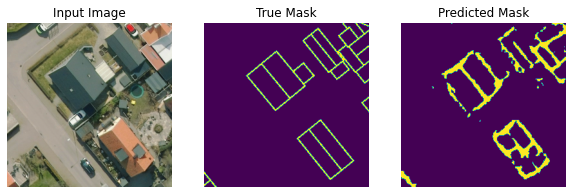

Validation MIoU: 0.5443
Epoch 13: Validation Dice_Loss : 3.9055
Epoch 13: Validation categorical_crossentropy : 0.3738
Time taken: 17.63s

Start of epoch 14
Current learning rage 0.000742
Training loss (for one batch) at step 0: 8.3588
Dice_Loss (for one batch) at step 0: 2.7258
categorical_crossentropy (for one batch) at step 0: 0.1814
Seen so far: 4 samples

Current learning rage 0.000643
Training loss (for one batch) at step 10: 9.0950
Dice_Loss (for one batch) at step 10: 2.9554
categorical_crossentropy (for one batch) at step 10: 0.2289
Seen so far: 44 samples

Current learning rage 0.000554
Training loss (for one batch) at step 20: 10.0758
Dice_Loss (for one batch) at step 20: 3.2488
categorical_crossentropy (for one batch) at step 20: 0.3295
Seen so far: 84 samples

Current learning rage 0.000476
Training loss (for one batch) at step 30: 9.3551
Dice_Loss (for one batch) at step 30: 3.0351
categorical_crossentropy (for one batch) at step 30: 0.2497
Seen so far: 124 samples

Curre

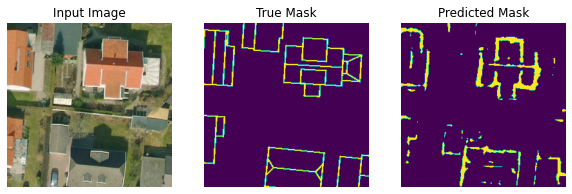

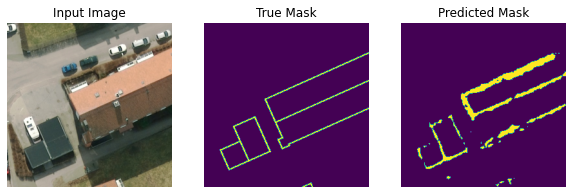

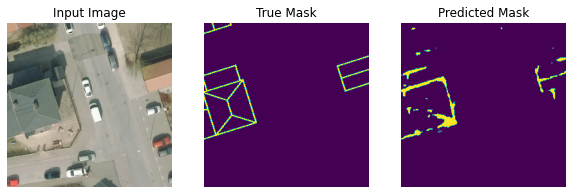

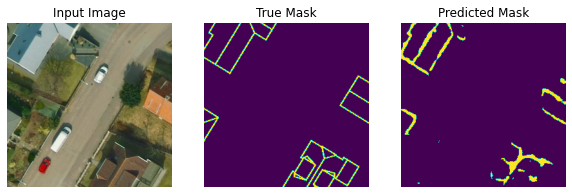

Validation MIoU: 0.5406
Epoch 14: Validation Dice_Loss : 4.0579
Epoch 14: Validation categorical_crossentropy : 0.4511
Time taken: 17.56s

Start of epoch 15
Current learning rage 0.014585
Training loss (for one batch) at step 0: 9.1721
Dice_Loss (for one batch) at step 0: 2.9791
categorical_crossentropy (for one batch) at step 0: 0.2347
Seen so far: 4 samples

Current learning rage 0.014580
Training loss (for one batch) at step 10: 12.3520
Dice_Loss (for one batch) at step 10: 4.0298
categorical_crossentropy (for one batch) at step 10: 0.2625
Seen so far: 44 samples

Current learning rage 0.014574
Training loss (for one batch) at step 20: 11.0623
Dice_Loss (for one batch) at step 20: 3.6009
categorical_crossentropy (for one batch) at step 20: 0.2596
Seen so far: 84 samples

Current learning rage 0.014565
Training loss (for one batch) at step 30: 9.7866
Dice_Loss (for one batch) at step 30: 3.1353
categorical_crossentropy (for one batch) at step 30: 0.3807
Seen so far: 124 samples

Curr

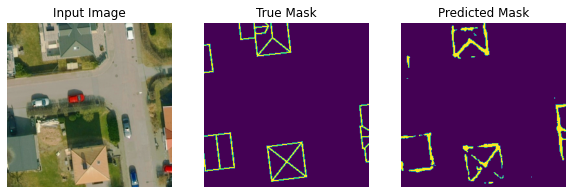

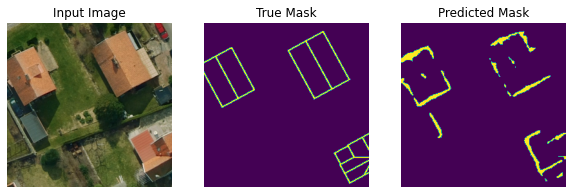

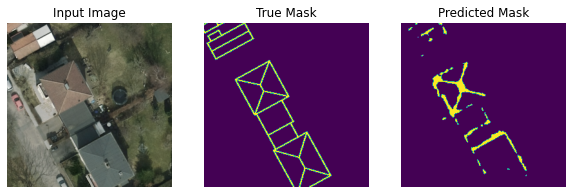

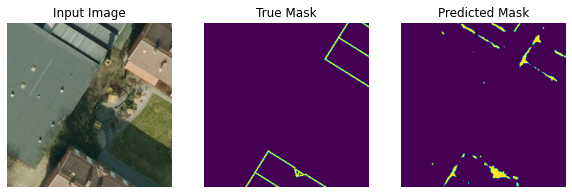

Validation MIoU: 0.5415
Epoch 15: Validation Dice_Loss : 4.0772
Epoch 15: Validation categorical_crossentropy : 0.5447
Time taken: 17.76s

Start of epoch 16
Current learning rage 0.014409
Training loss (for one batch) at step 0: 10.8531
Dice_Loss (for one batch) at step 0: 3.4904
categorical_crossentropy (for one batch) at step 0: 0.3819
Seen so far: 4 samples

Current learning rage 0.014380
Training loss (for one batch) at step 10: 11.2085
Dice_Loss (for one batch) at step 10: 3.6409
categorical_crossentropy (for one batch) at step 10: 0.2857
Seen so far: 44 samples

Current learning rage 0.014348
Training loss (for one batch) at step 20: 11.1598
Dice_Loss (for one batch) at step 20: 3.6099
categorical_crossentropy (for one batch) at step 20: 0.3301
Seen so far: 84 samples

Current learning rage 0.014314
Training loss (for one batch) at step 30: 9.9439
Dice_Loss (for one batch) at step 30: 3.1699
categorical_crossentropy (for one batch) at step 30: 0.4340
Seen so far: 124 samples

Cur

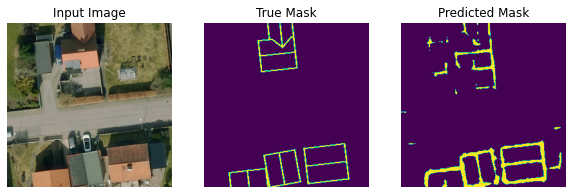

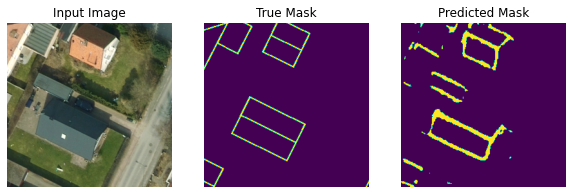

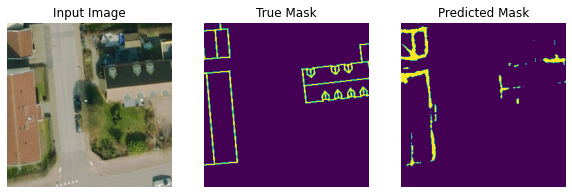

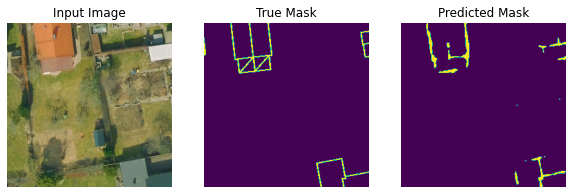

Validation MIoU: 0.5450
Epoch 16: Validation Dice_Loss : 3.9033
Epoch 16: Validation categorical_crossentropy : 0.3737
Time taken: 17.56s

Start of epoch 17
Current learning rage 0.013960
Training loss (for one batch) at step 0: 9.1904
Dice_Loss (for one batch) at step 0: 2.9749
categorical_crossentropy (for one batch) at step 0: 0.2658
Seen so far: 4 samples

Current learning rage 0.013906
Training loss (for one batch) at step 10: 9.9656
Dice_Loss (for one batch) at step 10: 3.2262
categorical_crossentropy (for one batch) at step 10: 0.2870
Seen so far: 44 samples

Current learning rage 0.013851
Training loss (for one batch) at step 20: 9.4869
Dice_Loss (for one batch) at step 20: 3.0480
categorical_crossentropy (for one batch) at step 20: 0.3428
Seen so far: 84 samples

Current learning rage 0.013793
Training loss (for one batch) at step 30: 10.2840
Dice_Loss (for one batch) at step 30: 3.3026
categorical_crossentropy (for one batch) at step 30: 0.3763
Seen so far: 124 samples

Curre

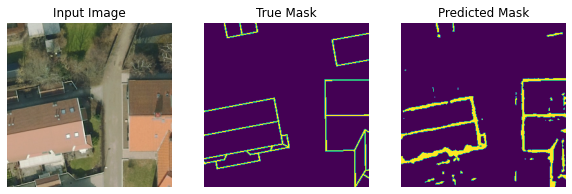

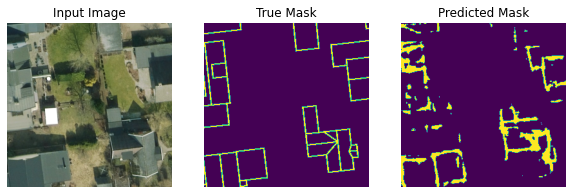

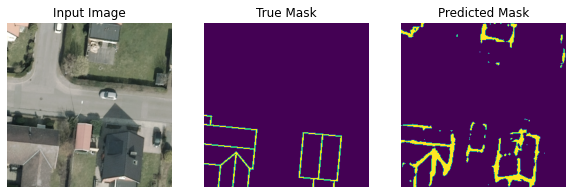

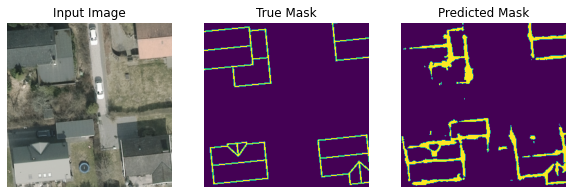

Validation MIoU: 0.5413
Epoch 17: Validation Dice_Loss : 3.8832
Epoch 17: Validation categorical_crossentropy : 0.3990
Time taken: 17.59s

Start of epoch 18
Current learning rage 0.013254
Training loss (for one batch) at step 0: 10.8002
Dice_Loss (for one batch) at step 0: 3.4875
categorical_crossentropy (for one batch) at step 0: 0.3376
Seen so far: 4 samples

Current learning rage 0.013178
Training loss (for one batch) at step 10: 9.0046
Dice_Loss (for one batch) at step 10: 2.8728
categorical_crossentropy (for one batch) at step 10: 0.3863
Seen so far: 44 samples

Current learning rage 0.013101
Training loss (for one batch) at step 20: 10.4989
Dice_Loss (for one batch) at step 20: 3.3554
categorical_crossentropy (for one batch) at step 20: 0.4326
Seen so far: 84 samples

Current learning rage 0.013022
Training loss (for one batch) at step 30: 10.3154
Dice_Loss (for one batch) at step 30: 3.3720
categorical_crossentropy (for one batch) at step 30: 0.1994
Seen so far: 124 samples

Cur

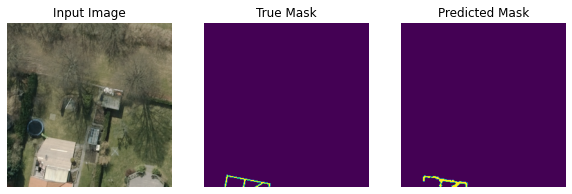

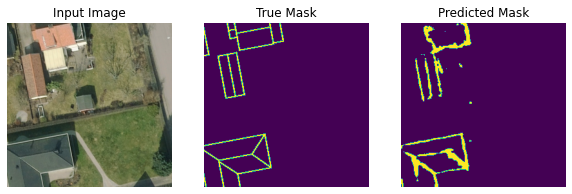

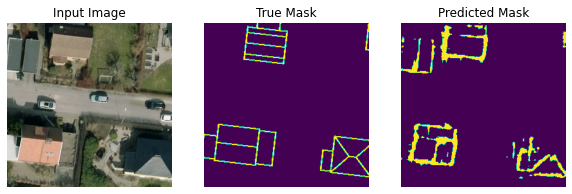

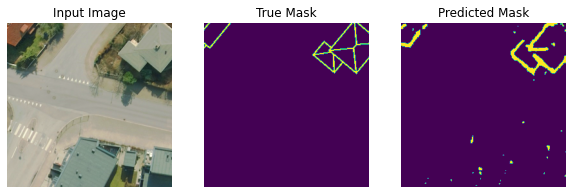

Validation MIoU: 0.5408
Epoch 18: Validation Dice_Loss : 3.9015
Epoch 18: Validation categorical_crossentropy : 0.3739
Time taken: 17.73s

Start of epoch 19
Current learning rage 0.012319
Training loss (for one batch) at step 0: 9.4290
Dice_Loss (for one batch) at step 0: 3.0343
categorical_crossentropy (for one batch) at step 0: 0.3263
Seen so far: 4 samples

Current learning rage 0.012225
Training loss (for one batch) at step 10: 10.2277
Dice_Loss (for one batch) at step 10: 3.3057
categorical_crossentropy (for one batch) at step 10: 0.3106
Seen so far: 44 samples

Current learning rage 0.012129
Training loss (for one batch) at step 20: 9.7618
Dice_Loss (for one batch) at step 20: 3.1288
categorical_crossentropy (for one batch) at step 20: 0.3754
Seen so far: 84 samples

Current learning rage 0.012032
Training loss (for one batch) at step 30: 8.0108
Dice_Loss (for one batch) at step 30: 2.6070
categorical_crossentropy (for one batch) at step 30: 0.1898
Seen so far: 124 samples

Curre

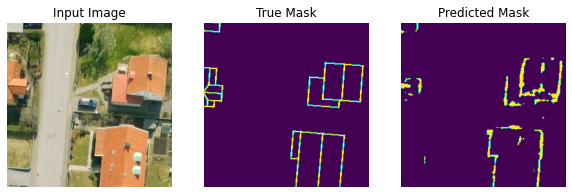

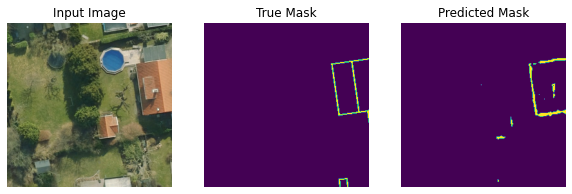

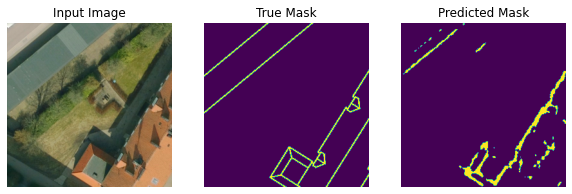

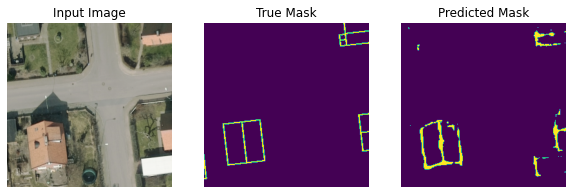

Validation MIoU: 0.5418
Epoch 19: Validation Dice_Loss : 3.9885
Epoch 19: Validation categorical_crossentropy : 0.5030
Time taken: 17.64s

Start of epoch 20
Current learning rage 0.011192
Training loss (for one batch) at step 0: 8.3667
Dice_Loss (for one batch) at step 0: 2.6950
categorical_crossentropy (for one batch) at step 0: 0.2817
Seen so far: 4 samples

Current learning rage 0.011083
Training loss (for one batch) at step 10: 8.5121
Dice_Loss (for one batch) at step 10: 2.7372
categorical_crossentropy (for one batch) at step 10: 0.3006
Seen so far: 44 samples

Current learning rage 0.010972
Training loss (for one batch) at step 20: 10.3253
Dice_Loss (for one batch) at step 20: 3.2980
categorical_crossentropy (for one batch) at step 20: 0.4314
Seen so far: 84 samples

Current learning rage 0.010860
Training loss (for one batch) at step 30: 7.6844
Dice_Loss (for one batch) at step 30: 2.4536
categorical_crossentropy (for one batch) at step 30: 0.3236
Seen so far: 124 samples

Curre

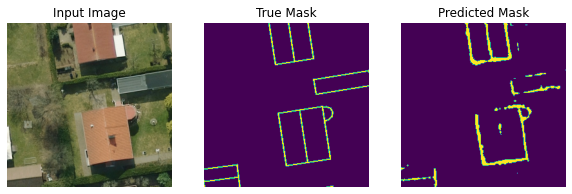

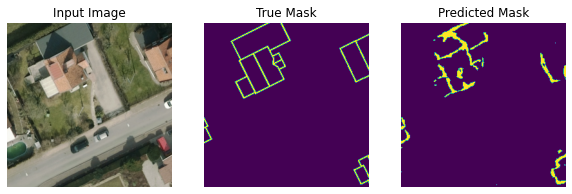

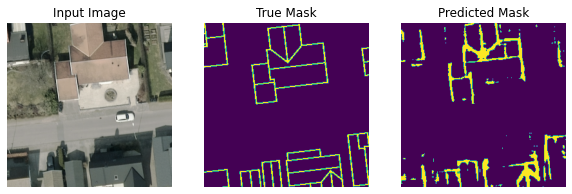

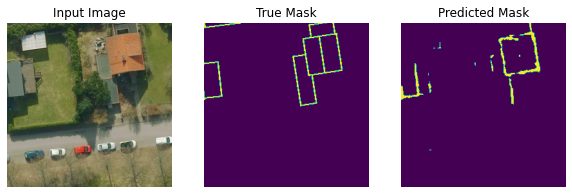

Validation MIoU: 0.5417
Epoch 20: Validation Dice_Loss : 3.9712
Epoch 20: Validation categorical_crossentropy : 0.4117
Time taken: 17.59s

Start of epoch 21
Current learning rage 0.009917
Training loss (for one batch) at step 0: 9.6541
Dice_Loss (for one batch) at step 0: 3.1268
categorical_crossentropy (for one batch) at step 0: 0.2737
Seen so far: 4 samples

Current learning rage 0.009797
Training loss (for one batch) at step 10: 10.6058
Dice_Loss (for one batch) at step 10: 3.4464
categorical_crossentropy (for one batch) at step 10: 0.2665
Seen so far: 44 samples

Current learning rage 0.009676
Training loss (for one batch) at step 20: 9.6076
Dice_Loss (for one batch) at step 20: 3.0361
categorical_crossentropy (for one batch) at step 20: 0.4992
Seen so far: 84 samples

Current learning rage 0.009554
Training loss (for one batch) at step 30: 8.2170
Dice_Loss (for one batch) at step 30: 2.6815
categorical_crossentropy (for one batch) at step 30: 0.1724
Seen so far: 124 samples

Curre

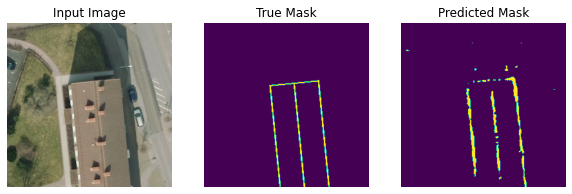

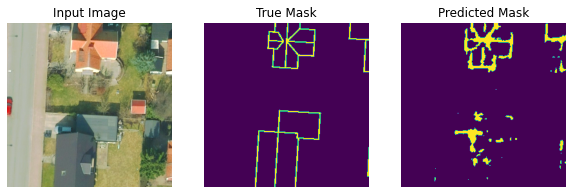

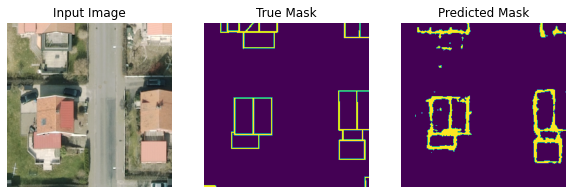

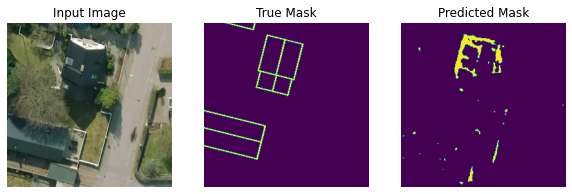

Validation MIoU: 0.5405
Epoch 21: Validation Dice_Loss : 3.9551
Epoch 21: Validation categorical_crossentropy : 0.4121
Time taken: 17.76s

Start of epoch 22
Current learning rage 0.008544
Training loss (for one batch) at step 0: 8.1947
Dice_Loss (for one batch) at step 0: 2.6375
categorical_crossentropy (for one batch) at step 0: 0.2823
Seen so far: 4 samples

Current learning rage 0.008418
Training loss (for one batch) at step 10: 9.4667
Dice_Loss (for one batch) at step 10: 3.0504
categorical_crossentropy (for one batch) at step 10: 0.3154
Seen so far: 44 samples

Current learning rage 0.008291
Training loss (for one batch) at step 20: 6.8697
Dice_Loss (for one batch) at step 20: 2.2365
categorical_crossentropy (for one batch) at step 20: 0.1602
Seen so far: 84 samples

Current learning rage 0.008163
Training loss (for one batch) at step 30: 8.8854
Dice_Loss (for one batch) at step 30: 2.9251
categorical_crossentropy (for one batch) at step 30: 0.1102
Seen so far: 124 samples

Curren

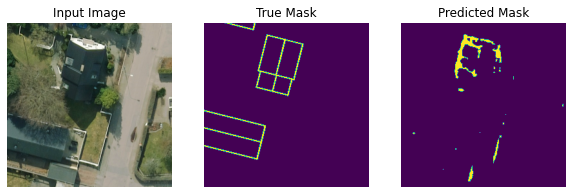

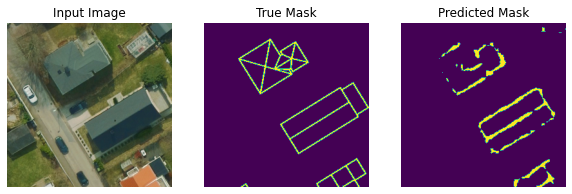

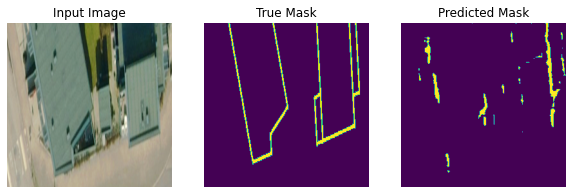

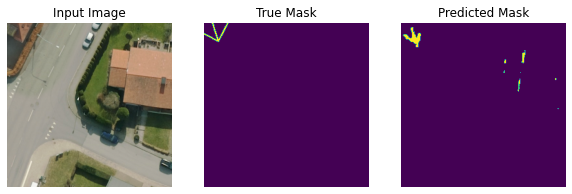

Validation MIoU: 0.5424
Epoch 22: Validation Dice_Loss : 4.0161
Epoch 22: Validation categorical_crossentropy : 0.5254
Time taken: 17.71s

Start of epoch 23
Current learning rage 0.007127
Training loss (for one batch) at step 0: 11.6380
Dice_Loss (for one batch) at step 0: 3.8193
categorical_crossentropy (for one batch) at step 0: 0.1799
Seen so far: 4 samples

Current learning rage 0.006999
Training loss (for one batch) at step 10: 8.5055
Dice_Loss (for one batch) at step 10: 2.7085
categorical_crossentropy (for one batch) at step 10: 0.3800
Seen so far: 44 samples

Current learning rage 0.006871
Training loss (for one batch) at step 20: 7.8168
Dice_Loss (for one batch) at step 20: 2.5676
categorical_crossentropy (for one batch) at step 20: 0.1140
Seen so far: 84 samples

Current learning rage 0.006744
Training loss (for one batch) at step 30: 10.6452
Dice_Loss (for one batch) at step 30: 3.4880
categorical_crossentropy (for one batch) at step 30: 0.1812
Seen so far: 124 samples

Curr

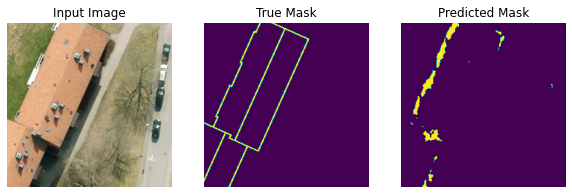

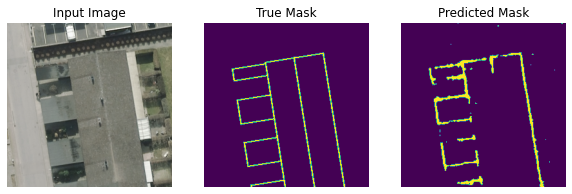

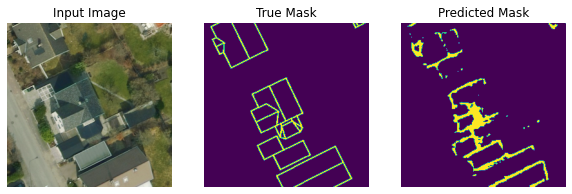

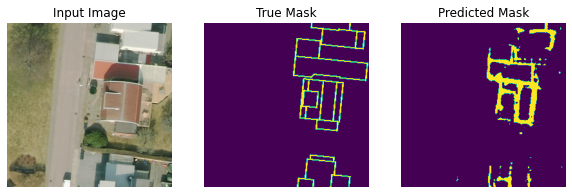

Validation MIoU: 0.5429
Epoch 23: Validation Dice_Loss : 3.9834
Epoch 23: Validation categorical_crossentropy : 0.4547
Time taken: 17.63s

Start of epoch 24
Current learning rage 0.005721
Training loss (for one batch) at step 0: 8.8988
Dice_Loss (for one batch) at step 0: 2.8314
categorical_crossentropy (for one batch) at step 0: 0.4045
Seen so far: 4 samples

Current learning rage 0.005596
Training loss (for one batch) at step 10: 7.7420
Dice_Loss (for one batch) at step 10: 2.4443
categorical_crossentropy (for one batch) at step 10: 0.4092
Seen so far: 44 samples

Current learning rage 0.005473
Training loss (for one batch) at step 20: 6.7728
Dice_Loss (for one batch) at step 20: 2.2128
categorical_crossentropy (for one batch) at step 20: 0.1343
Seen so far: 84 samples

Current learning rage 0.005350
Training loss (for one batch) at step 30: 6.8542
Dice_Loss (for one batch) at step 30: 2.2342
categorical_crossentropy (for one batch) at step 30: 0.1514
Seen so far: 124 samples

Curren

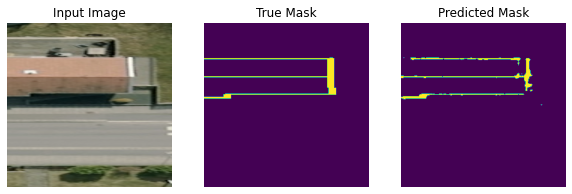

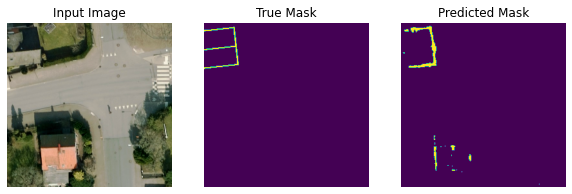

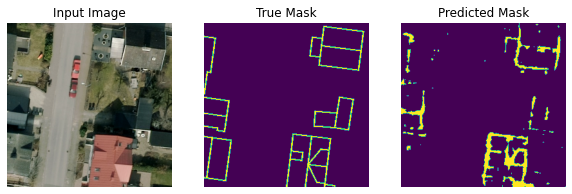

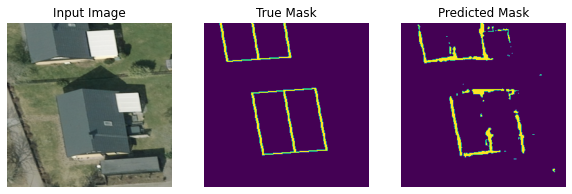

Validation MIoU: 0.5404
Epoch 24: Validation Dice_Loss : 4.0042
Epoch 24: Validation categorical_crossentropy : 0.4511
Time taken: 17.78s

Start of epoch 25
Current learning rage 0.004380
Training loss (for one batch) at step 0: 7.2235
Dice_Loss (for one batch) at step 0: 2.3495
categorical_crossentropy (for one batch) at step 0: 0.1750
Seen so far: 4 samples

Current learning rage 0.004265
Training loss (for one batch) at step 10: 7.8316
Dice_Loss (for one batch) at step 10: 2.4683
categorical_crossentropy (for one batch) at step 10: 0.4267
Seen so far: 44 samples

Current learning rage 0.004150
Training loss (for one batch) at step 20: 8.7964
Dice_Loss (for one batch) at step 20: 2.8175
categorical_crossentropy (for one batch) at step 20: 0.3438
Seen so far: 84 samples

Current learning rage 0.004036
Training loss (for one batch) at step 30: 7.2010
Dice_Loss (for one batch) at step 30: 2.3214
categorical_crossentropy (for one batch) at step 30: 0.2367
Seen so far: 124 samples

Curren

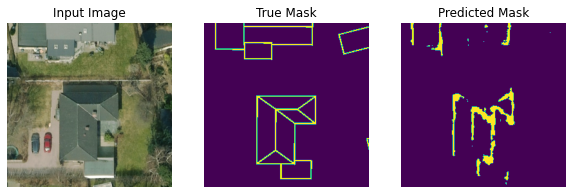

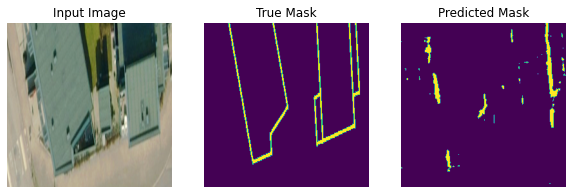

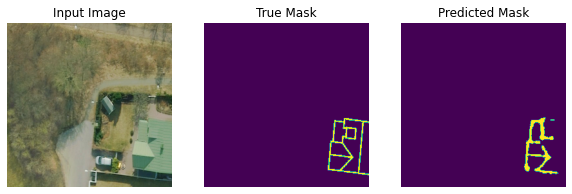

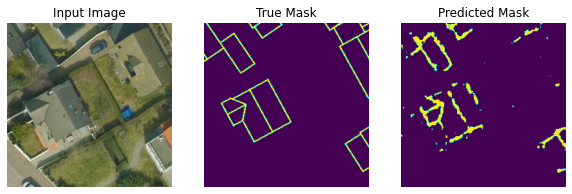

Validation MIoU: 0.5398
Epoch 25: Validation Dice_Loss : 4.0273
Epoch 25: Validation categorical_crossentropy : 0.4965
Time taken: 17.69s

Start of epoch 26
Current learning rage 0.003159
Training loss (for one batch) at step 0: 6.0495
Dice_Loss (for one batch) at step 0: 1.9401
categorical_crossentropy (for one batch) at step 0: 0.2294
Seen so far: 4 samples

Current learning rage 0.003056
Training loss (for one batch) at step 10: 7.3226
Dice_Loss (for one batch) at step 10: 2.3349
categorical_crossentropy (for one batch) at step 10: 0.3178
Seen so far: 44 samples

Current learning rage 0.002955
Training loss (for one batch) at step 20: 7.2275
Dice_Loss (for one batch) at step 20: 2.2967
categorical_crossentropy (for one batch) at step 20: 0.3373
Seen so far: 84 samples

Current learning rage 0.002855
Training loss (for one batch) at step 30: 8.1016
Dice_Loss (for one batch) at step 30: 2.5910
categorical_crossentropy (for one batch) at step 30: 0.3285
Seen so far: 124 samples

Curren

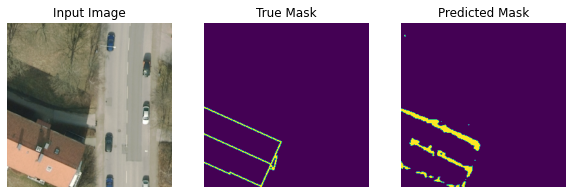

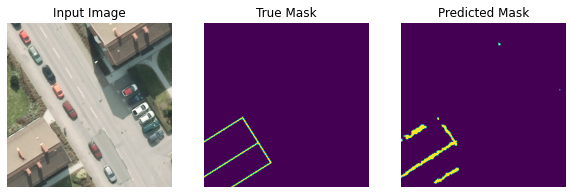

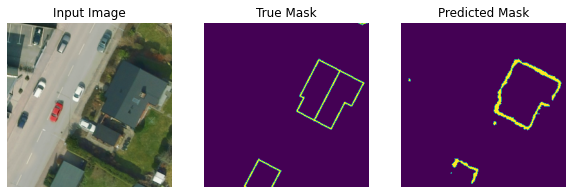

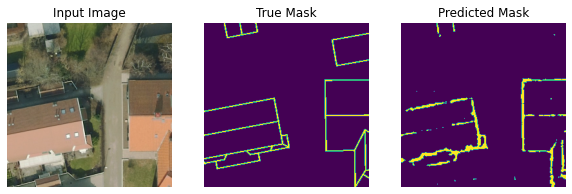

Validation MIoU: 0.5394
Epoch 26: Validation Dice_Loss : 4.0531
Epoch 26: Validation categorical_crossentropy : 0.5075
Time taken: 17.75s

Start of epoch 27
Current learning rage 0.002103
Training loss (for one batch) at step 0: 7.0062
Dice_Loss (for one batch) at step 0: 2.2666
categorical_crossentropy (for one batch) at step 0: 0.2064
Seen so far: 4 samples

Current learning rage 0.002018
Training loss (for one batch) at step 10: 7.9078
Dice_Loss (for one batch) at step 10: 2.4832
categorical_crossentropy (for one batch) at step 10: 0.4581
Seen so far: 44 samples

Current learning rage 0.001934
Training loss (for one batch) at step 20: 11.4028
Dice_Loss (for one batch) at step 20: 3.7398
categorical_crossentropy (for one batch) at step 20: 0.1835
Seen so far: 84 samples

Current learning rage 0.001852
Training loss (for one batch) at step 30: 8.0792
Dice_Loss (for one batch) at step 30: 2.5586
categorical_crossentropy (for one batch) at step 30: 0.4033
Seen so far: 124 samples

Curre

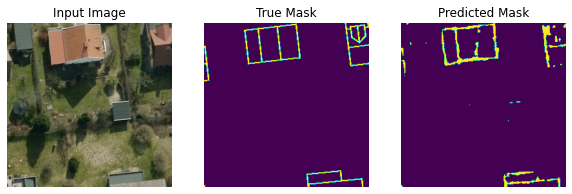

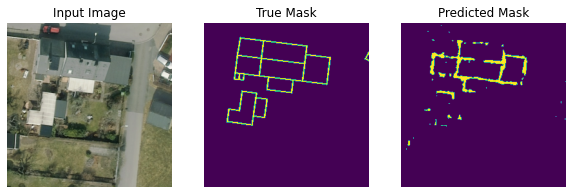

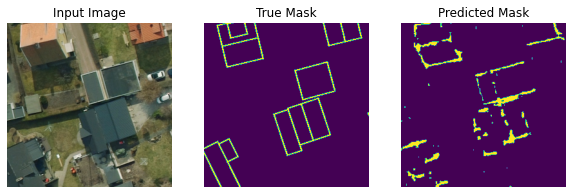

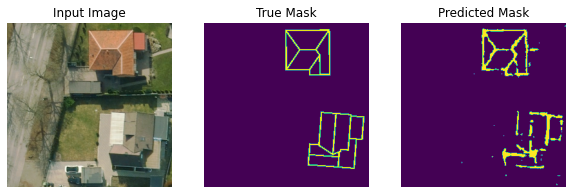

Validation MIoU: 0.5392
Epoch 27: Validation Dice_Loss : 4.0660
Epoch 27: Validation categorical_crossentropy : 0.5293
Time taken: 17.74s

Start of epoch 28
Current learning rage 0.001255
Training loss (for one batch) at step 0: 6.5212
Dice_Loss (for one batch) at step 0: 2.0877
categorical_crossentropy (for one batch) at step 0: 0.2582
Seen so far: 4 samples

Current learning rage 0.001190
Training loss (for one batch) at step 10: 8.1475
Dice_Loss (for one batch) at step 10: 2.6321
categorical_crossentropy (for one batch) at step 10: 0.2511
Seen so far: 44 samples

Current learning rage 0.001127
Training loss (for one batch) at step 20: 7.7650
Dice_Loss (for one batch) at step 20: 2.4781
categorical_crossentropy (for one batch) at step 20: 0.3308
Seen so far: 84 samples

Current learning rage 0.001066
Training loss (for one batch) at step 30: 8.6566
Dice_Loss (for one batch) at step 30: 2.7956
categorical_crossentropy (for one batch) at step 30: 0.2698
Seen so far: 124 samples

Curren

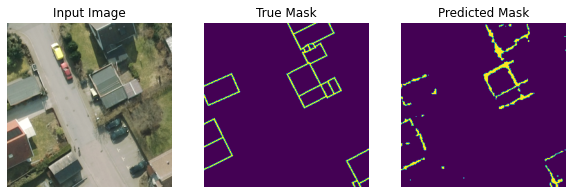

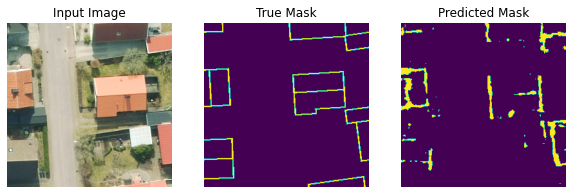

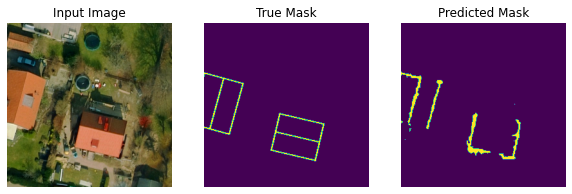

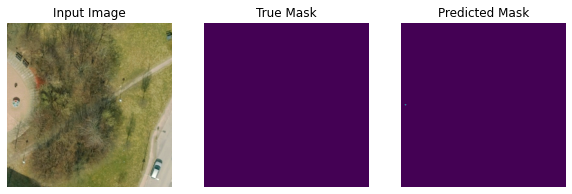

Validation MIoU: 0.5380
Epoch 28: Validation Dice_Loss : 4.0971
Epoch 28: Validation categorical_crossentropy : 0.5431
Time taken: 17.78s

Start of epoch 29
Current learning rage 0.000648
Training loss (for one batch) at step 0: 8.9200
Dice_Loss (for one batch) at step 0: 2.9079
categorical_crossentropy (for one batch) at step 0: 0.1962
Seen so far: 4 samples

Current learning rage 0.000606
Training loss (for one batch) at step 10: 7.7971
Dice_Loss (for one batch) at step 10: 2.5054
categorical_crossentropy (for one batch) at step 10: 0.2808
Seen so far: 44 samples

Current learning rage 0.000566
Training loss (for one batch) at step 20: 4.5373
Dice_Loss (for one batch) at step 20: 1.4750
categorical_crossentropy (for one batch) at step 20: 0.1124
Seen so far: 84 samples

Current learning rage 0.000529
Training loss (for one batch) at step 30: 7.7041
Dice_Loss (for one batch) at step 30: 2.4386
categorical_crossentropy (for one batch) at step 30: 0.3883
Seen so far: 124 samples

Curren

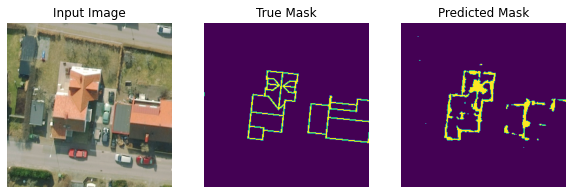

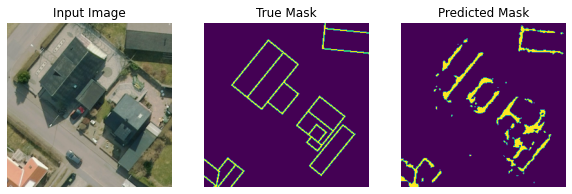

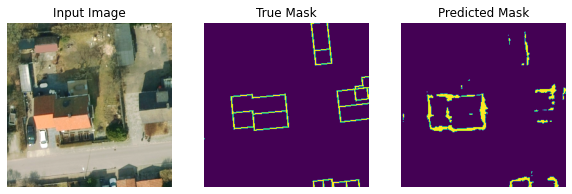

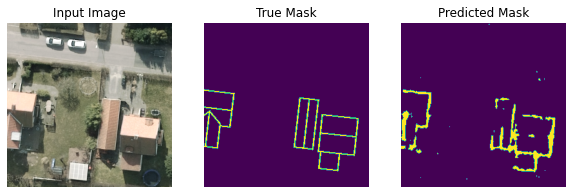

Validation MIoU: 0.5386
Epoch 29: Validation Dice_Loss : 4.0743
Epoch 29: Validation categorical_crossentropy : 0.5394
Time taken: 17.66s

Start of epoch 30
Current learning rage 0.000306
Training loss (for one batch) at step 0: 8.7123
Dice_Loss (for one batch) at step 0: 2.8280
categorical_crossentropy (for one batch) at step 0: 0.2283
Seen so far: 4 samples

Current learning rage 0.000288
Training loss (for one batch) at step 10: 8.4324
Dice_Loss (for one batch) at step 10: 2.6916
categorical_crossentropy (for one batch) at step 10: 0.3576
Seen so far: 44 samples

Current learning rage 0.000273
Training loss (for one batch) at step 20: 9.0462
Dice_Loss (for one batch) at step 20: 2.8238
categorical_crossentropy (for one batch) at step 20: 0.5748
Seen so far: 84 samples

Current learning rage 0.000260
Training loss (for one batch) at step 30: 7.2240
Dice_Loss (for one batch) at step 30: 2.3210
categorical_crossentropy (for one batch) at step 30: 0.2611
Seen so far: 124 samples

Curren

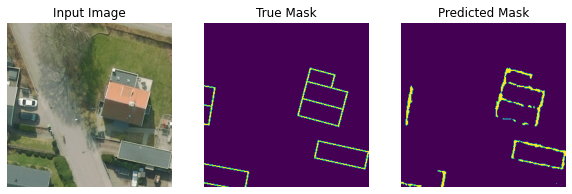

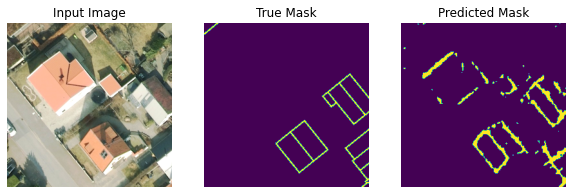

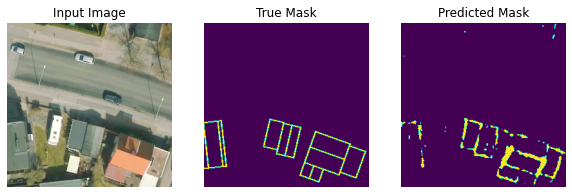

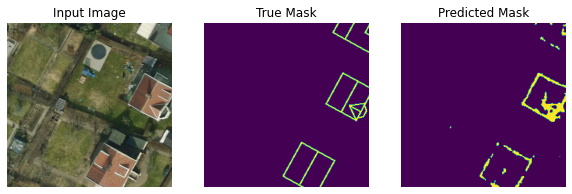

Validation MIoU: 0.5396
Epoch 30: Validation Dice_Loss : 4.0408
Epoch 30: Validation categorical_crossentropy : 0.5339
Time taken: 17.71s

Start of epoch 31
Current learning rage 0.012192
Training loss (for one batch) at step 0: 6.4539
Dice_Loss (for one batch) at step 0: 2.0771
categorical_crossentropy (for one batch) at step 0: 0.2225
Seen so far: 4 samples

Current learning rage 0.012191
Training loss (for one batch) at step 10: 7.4268
Dice_Loss (for one batch) at step 10: 2.3725
categorical_crossentropy (for one batch) at step 10: 0.3093
Seen so far: 44 samples

Current learning rage 0.012188
Training loss (for one batch) at step 20: 8.2234
Dice_Loss (for one batch) at step 20: 2.6235
categorical_crossentropy (for one batch) at step 20: 0.3531
Seen so far: 84 samples

Current learning rage 0.012186
Training loss (for one batch) at step 30: 8.3172
Dice_Loss (for one batch) at step 30: 2.6718
categorical_crossentropy (for one batch) at step 30: 0.3017
Seen so far: 124 samples

Curren

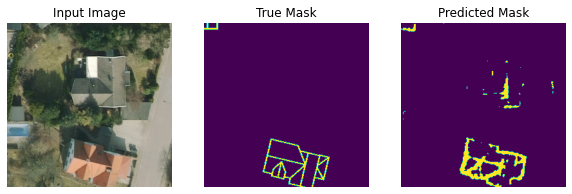

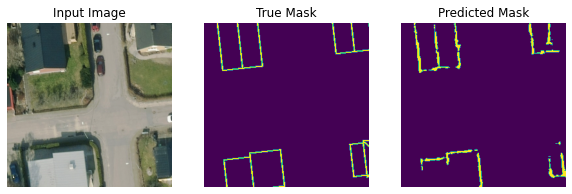

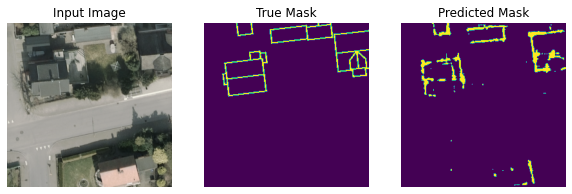

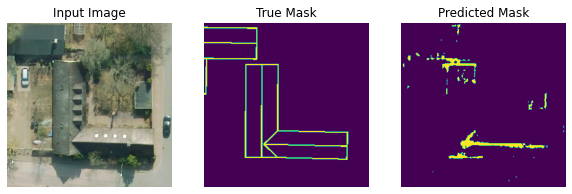

Validation MIoU: 0.5360
Epoch 31: Validation Dice_Loss : 4.0920
Epoch 31: Validation categorical_crossentropy : 0.5512
Time taken: 17.89s

Start of epoch 32
Current learning rage 0.012147
Training loss (for one batch) at step 0: 7.1289
Dice_Loss (for one batch) at step 0: 2.2835
categorical_crossentropy (for one batch) at step 0: 0.2784
Seen so far: 4 samples

Current learning rage 0.012140
Training loss (for one batch) at step 10: 7.8108
Dice_Loss (for one batch) at step 10: 2.5012
categorical_crossentropy (for one batch) at step 10: 0.3071
Seen so far: 44 samples

Current learning rage 0.012133
Training loss (for one batch) at step 20: 9.2985
Dice_Loss (for one batch) at step 20: 2.9526
categorical_crossentropy (for one batch) at step 20: 0.4408
Seen so far: 84 samples

Current learning rage 0.012125
Training loss (for one batch) at step 30: 6.9519
Dice_Loss (for one batch) at step 30: 2.2393
categorical_crossentropy (for one batch) at step 30: 0.2340
Seen so far: 124 samples

Curren

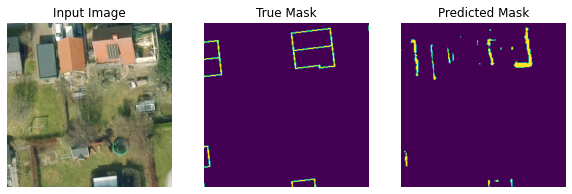

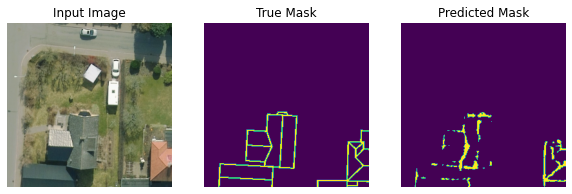

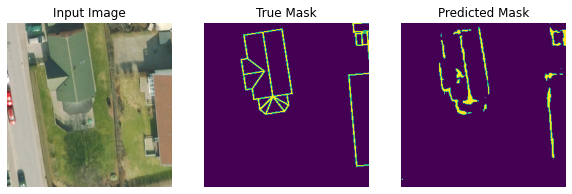

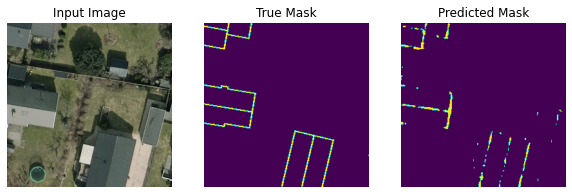

Validation MIoU: 0.5368
Epoch 32: Validation Dice_Loss : 4.1141
Epoch 32: Validation categorical_crossentropy : 0.7498
Time taken: 17.62s

Start of epoch 33
Current learning rage 0.012044
Training loss (for one batch) at step 0: 7.6495
Dice_Loss (for one batch) at step 0: 2.4490
categorical_crossentropy (for one batch) at step 0: 0.3024
Seen so far: 4 samples

Current learning rage 0.012032
Training loss (for one batch) at step 10: 9.2300
Dice_Loss (for one batch) at step 10: 2.8787
categorical_crossentropy (for one batch) at step 10: 0.5939
Seen so far: 44 samples

Current learning rage 0.012019
Training loss (for one batch) at step 20: 9.0837
Dice_Loss (for one batch) at step 20: 2.8712
categorical_crossentropy (for one batch) at step 20: 0.4701
Seen so far: 84 samples

Current learning rage 0.012006
Training loss (for one batch) at step 30: 8.3675
Dice_Loss (for one batch) at step 30: 2.6377
categorical_crossentropy (for one batch) at step 30: 0.4543
Seen so far: 124 samples

Curren

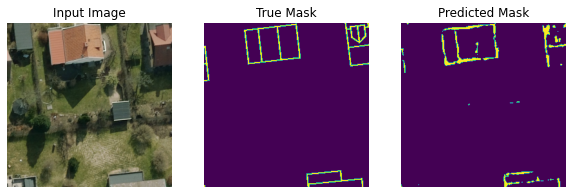

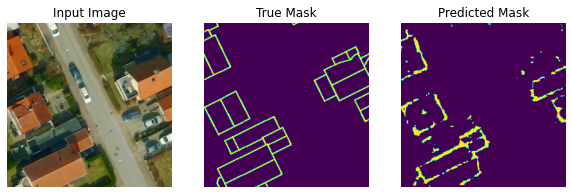

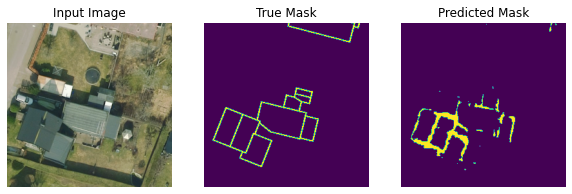

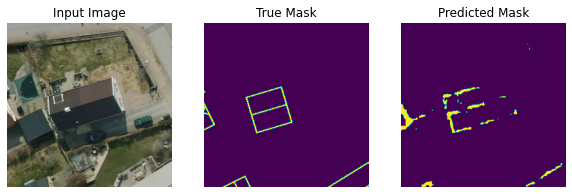

Validation MIoU: 0.5352
Epoch 33: Validation Dice_Loss : 4.1378
Epoch 33: Validation categorical_crossentropy : 0.5736
Time taken: 17.71s

Start of epoch 34
Current learning rage 0.011883
Training loss (for one batch) at step 0: 8.0741
Dice_Loss (for one batch) at step 0: 2.6119
categorical_crossentropy (for one batch) at step 0: 0.2385
Seen so far: 4 samples

Current learning rage 0.011866
Training loss (for one batch) at step 10: 7.0351
Dice_Loss (for one batch) at step 10: 2.2592
categorical_crossentropy (for one batch) at step 10: 0.2574
Seen so far: 44 samples

Current learning rage 0.011848
Training loss (for one batch) at step 20: 10.6332
Dice_Loss (for one batch) at step 20: 3.4553
categorical_crossentropy (for one batch) at step 20: 0.2674
Seen so far: 84 samples

Current learning rage 0.011830
Training loss (for one batch) at step 30: 7.0695
Dice_Loss (for one batch) at step 30: 2.3075
categorical_crossentropy (for one batch) at step 30: 0.1469
Seen so far: 124 samples

Curre

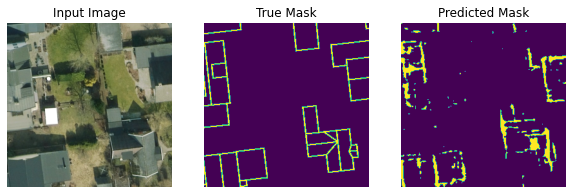

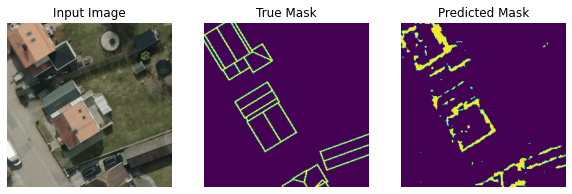

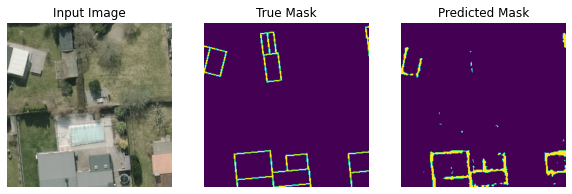

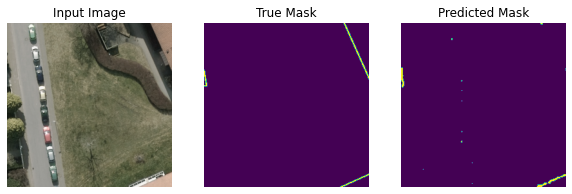

Validation MIoU: 0.5356
Epoch 34: Validation Dice_Loss : 4.0696
Epoch 34: Validation categorical_crossentropy : 0.5482
Time taken: 17.85s

Start of epoch 35
Current learning rage 0.011667
Training loss (for one batch) at step 0: 6.4795
Dice_Loss (for one batch) at step 0: 2.0467
categorical_crossentropy (for one batch) at step 0: 0.3394
Seen so far: 4 samples

Current learning rage 0.011645
Training loss (for one batch) at step 10: 6.7930
Dice_Loss (for one batch) at step 10: 2.1857
categorical_crossentropy (for one batch) at step 10: 0.2358
Seen so far: 44 samples

Current learning rage 0.011622
Training loss (for one batch) at step 20: 8.3473
Dice_Loss (for one batch) at step 20: 2.6259
categorical_crossentropy (for one batch) at step 20: 0.4697
Seen so far: 84 samples

Current learning rage 0.011599
Training loss (for one batch) at step 30: 7.8331
Dice_Loss (for one batch) at step 30: 2.5227
categorical_crossentropy (for one batch) at step 30: 0.2649
Seen so far: 124 samples

Curren

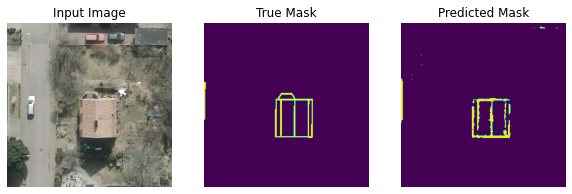

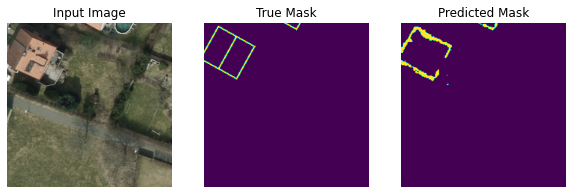

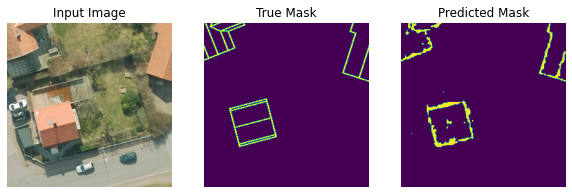

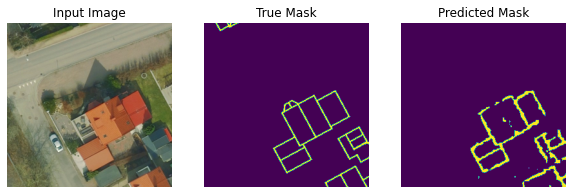

Validation MIoU: 0.5379
Epoch 35: Validation Dice_Loss : 4.0665
Epoch 35: Validation categorical_crossentropy : 0.5340
Time taken: 18.07s

Start of epoch 36
Current learning rage 0.011397
Training loss (for one batch) at step 0: 8.5138
Dice_Loss (for one batch) at step 0: 2.6757
categorical_crossentropy (for one batch) at step 0: 0.4867
Seen so far: 4 samples

Current learning rage 0.011371
Training loss (for one batch) at step 10: 7.3949
Dice_Loss (for one batch) at step 10: 2.3774
categorical_crossentropy (for one batch) at step 10: 0.2628
Seen so far: 44 samples

Current learning rage 0.011343
Training loss (for one batch) at step 20: 6.7291
Dice_Loss (for one batch) at step 20: 2.1834
categorical_crossentropy (for one batch) at step 20: 0.1788
Seen so far: 84 samples

Current learning rage 0.011316
Training loss (for one batch) at step 30: 6.8621
Dice_Loss (for one batch) at step 30: 2.1985
categorical_crossentropy (for one batch) at step 30: 0.2666
Seen so far: 124 samples

Curren

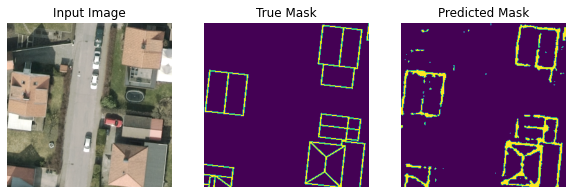

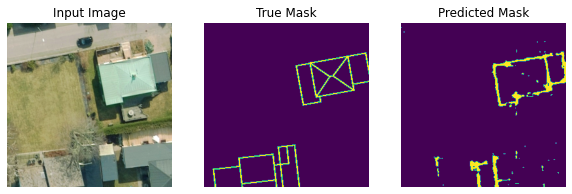

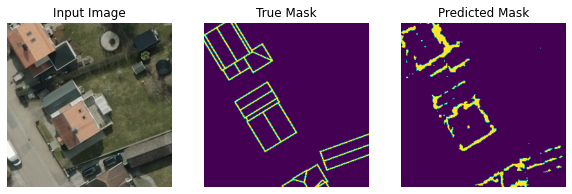

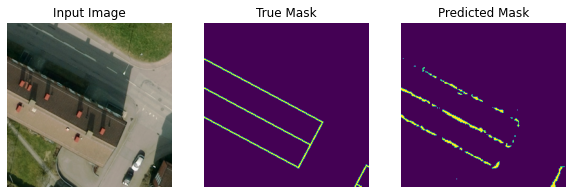

Validation MIoU: 0.5376
Epoch 36: Validation Dice_Loss : 4.0980
Epoch 36: Validation categorical_crossentropy : 0.6145
Time taken: 17.77s

Start of epoch 37
Current learning rage 0.011077
Training loss (for one batch) at step 0: 6.4497
Dice_Loss (for one batch) at step 0: 2.0490
categorical_crossentropy (for one batch) at step 0: 0.3028
Seen so far: 4 samples

Current learning rage 0.011046
Training loss (for one batch) at step 10: 7.8532
Dice_Loss (for one batch) at step 10: 2.4515
categorical_crossentropy (for one batch) at step 10: 0.4986
Seen so far: 44 samples

Current learning rage 0.011014
Training loss (for one batch) at step 20: 9.4149
Dice_Loss (for one batch) at step 20: 3.0571
categorical_crossentropy (for one batch) at step 20: 0.2435
Seen so far: 84 samples

Current learning rage 0.010982
Training loss (for one batch) at step 30: 8.1606
Dice_Loss (for one batch) at step 30: 2.5537
categorical_crossentropy (for one batch) at step 30: 0.4996
Seen so far: 124 samples

Curren

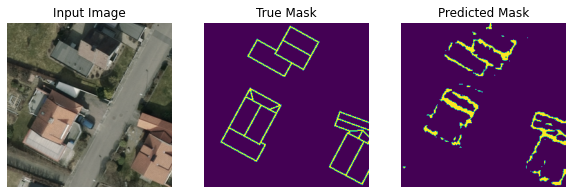

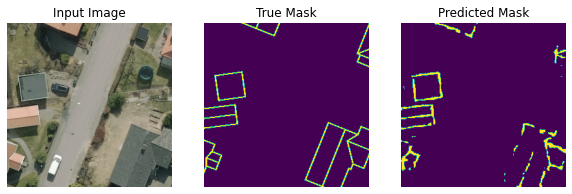

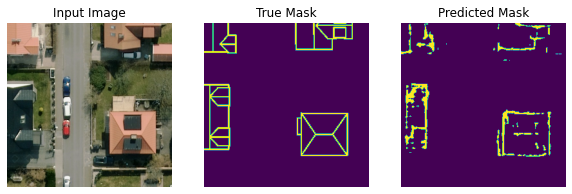

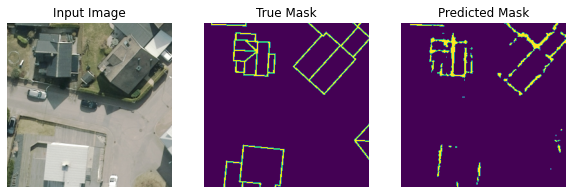

Validation MIoU: 0.5325
Epoch 37: Validation Dice_Loss : 4.2010
Epoch 37: Validation categorical_crossentropy : 0.6413
Time taken: 17.95s

Start of epoch 38
Current learning rage 0.010709
Training loss (for one batch) at step 0: 5.5284
Dice_Loss (for one batch) at step 0: 1.7673
categorical_crossentropy (for one batch) at step 0: 0.2264
Seen so far: 4 samples

Current learning rage 0.010673
Training loss (for one batch) at step 10: 7.8748
Dice_Loss (for one batch) at step 10: 2.4876
categorical_crossentropy (for one batch) at step 10: 0.4120
Seen so far: 44 samples

Current learning rage 0.010638
Training loss (for one batch) at step 20: 6.5795
Dice_Loss (for one batch) at step 20: 2.1135
categorical_crossentropy (for one batch) at step 20: 0.2390
Seen so far: 84 samples

Current learning rage 0.010602
Training loss (for one batch) at step 30: 6.7563
Dice_Loss (for one batch) at step 30: 2.1432
categorical_crossentropy (for one batch) at step 30: 0.3268
Seen so far: 124 samples

Curren

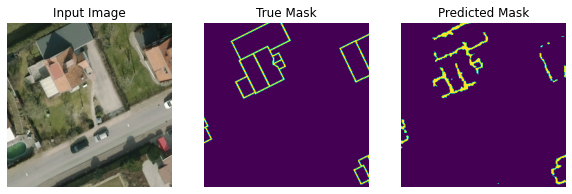

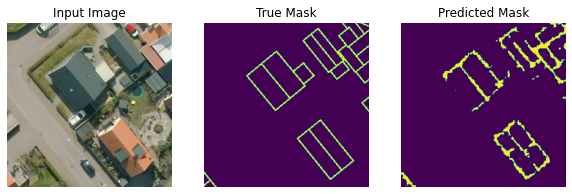

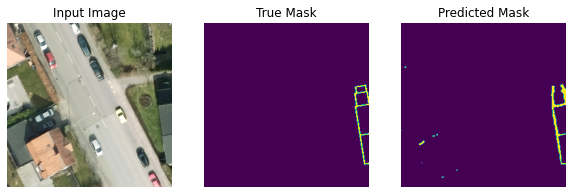

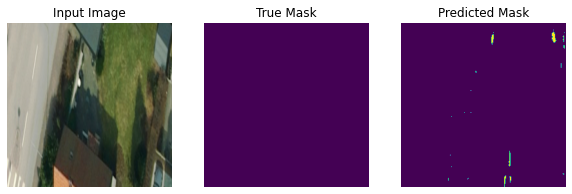

Validation MIoU: 0.5337
Epoch 38: Validation Dice_Loss : 4.1424
Epoch 38: Validation categorical_crossentropy : 0.5922
Time taken: 17.85s

Start of epoch 39
Current learning rage 0.010296
Training loss (for one batch) at step 0: 6.6773
Dice_Loss (for one batch) at step 0: 2.1302
categorical_crossentropy (for one batch) at step 0: 0.2868
Seen so far: 4 samples

Current learning rage 0.010257
Training loss (for one batch) at step 10: 5.8390
Dice_Loss (for one batch) at step 10: 1.8598
categorical_crossentropy (for one batch) at step 10: 0.2594
Seen so far: 44 samples

Current learning rage 0.010218
Training loss (for one batch) at step 20: 6.3089
Dice_Loss (for one batch) at step 20: 1.9957
categorical_crossentropy (for one batch) at step 20: 0.3219
Seen so far: 84 samples

Current learning rage 0.010178
Training loss (for one batch) at step 30: 3.9910
Dice_Loss (for one batch) at step 30: 1.2882
categorical_crossentropy (for one batch) at step 30: 0.1264
Seen so far: 124 samples

Curren

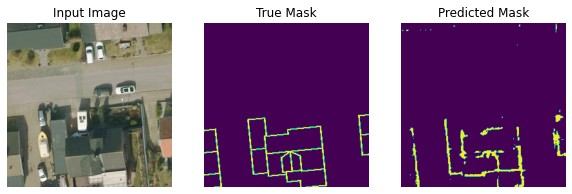

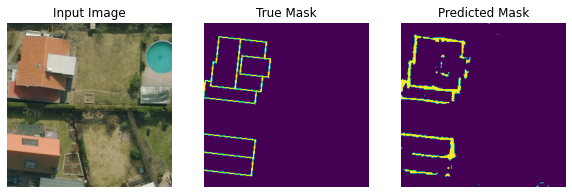

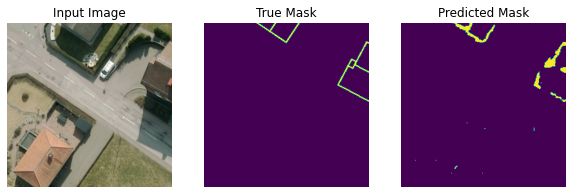

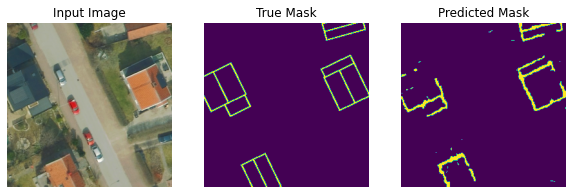

Validation MIoU: 0.5356
Epoch 39: Validation Dice_Loss : 4.1157
Epoch 39: Validation categorical_crossentropy : 0.5642
Time taken: 17.88s

Start of epoch 40
Current learning rage 0.009844
Training loss (for one batch) at step 0: 5.5484
Dice_Loss (for one batch) at step 0: 1.7855
categorical_crossentropy (for one batch) at step 0: 0.1918
Seen so far: 4 samples

Current learning rage 0.009802
Training loss (for one batch) at step 10: 5.9531
Dice_Loss (for one batch) at step 10: 1.8514
categorical_crossentropy (for one batch) at step 10: 0.3989
Seen so far: 44 samples

Current learning rage 0.009759
Training loss (for one batch) at step 20: 5.9432
Dice_Loss (for one batch) at step 20: 1.8861
categorical_crossentropy (for one batch) at step 20: 0.2849
Seen so far: 84 samples

Current learning rage 0.009716
Training loss (for one batch) at step 30: 5.0340
Dice_Loss (for one batch) at step 30: 1.6234
categorical_crossentropy (for one batch) at step 30: 0.1638
Seen so far: 124 samples

Curren

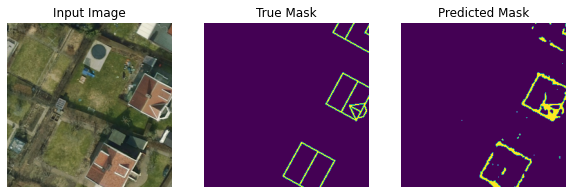

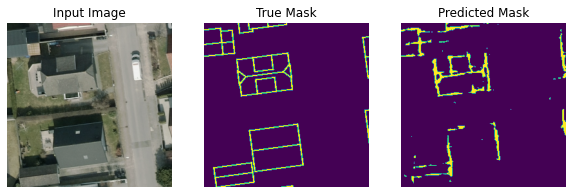

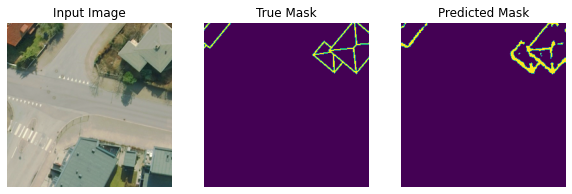

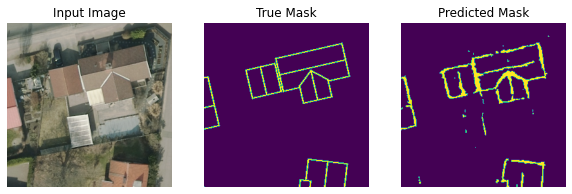

Validation MIoU: 0.5332
Epoch 40: Validation Dice_Loss : 4.1407
Epoch 40: Validation categorical_crossentropy : 0.5916
Time taken: 17.82s

Start of epoch 41
Current learning rage 0.009356
Training loss (for one batch) at step 0: 7.1575
Dice_Loss (for one batch) at step 0: 2.2060
categorical_crossentropy (for one batch) at step 0: 0.5396
Seen so far: 4 samples

Current learning rage 0.009311
Training loss (for one batch) at step 10: 5.6020
Dice_Loss (for one batch) at step 10: 1.7770
categorical_crossentropy (for one batch) at step 10: 0.2710
Seen so far: 44 samples

Current learning rage 0.009265
Training loss (for one batch) at step 20: 5.0685
Dice_Loss (for one batch) at step 20: 1.6223
categorical_crossentropy (for one batch) at step 20: 0.2018
Seen so far: 84 samples

Current learning rage 0.009219
Training loss (for one batch) at step 30: 5.6319
Dice_Loss (for one batch) at step 30: 1.7974
categorical_crossentropy (for one batch) at step 30: 0.2398
Seen so far: 124 samples

Curren

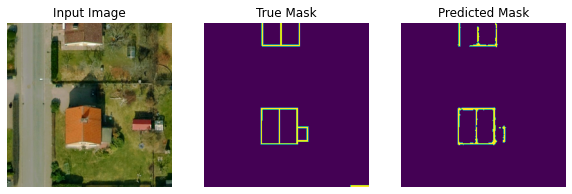

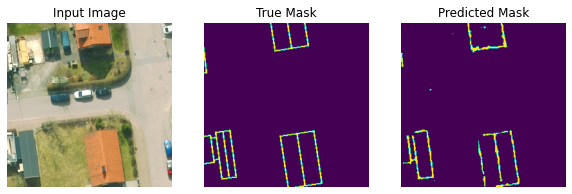

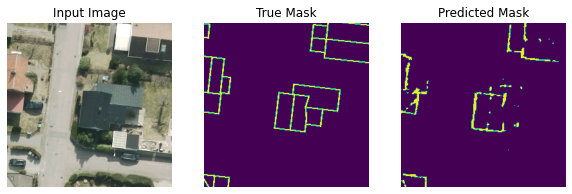

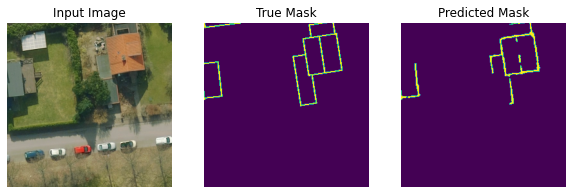

Validation MIoU: 0.5317
Epoch 41: Validation Dice_Loss : 4.1974
Epoch 41: Validation categorical_crossentropy : 0.6474
Time taken: 17.97s

Start of epoch 42
Current learning rage 0.008837
Training loss (for one batch) at step 0: 5.4271
Dice_Loss (for one batch) at step 0: 1.7131
categorical_crossentropy (for one batch) at step 0: 0.2879
Seen so far: 4 samples

Current learning rage 0.008789
Training loss (for one batch) at step 10: 4.8324
Dice_Loss (for one batch) at step 10: 1.5293
categorical_crossentropy (for one batch) at step 10: 0.2446
Seen so far: 44 samples

Current learning rage 0.008741
Training loss (for one batch) at step 20: 8.1375
Dice_Loss (for one batch) at step 20: 2.6380
categorical_crossentropy (for one batch) at step 20: 0.2234
Seen so far: 84 samples

Current learning rage 0.008693
Training loss (for one batch) at step 30: 6.7460
Dice_Loss (for one batch) at step 30: 2.1232
categorical_crossentropy (for one batch) at step 30: 0.3764
Seen so far: 124 samples

Curren

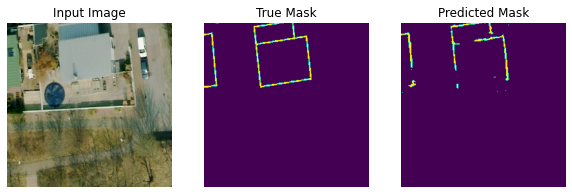

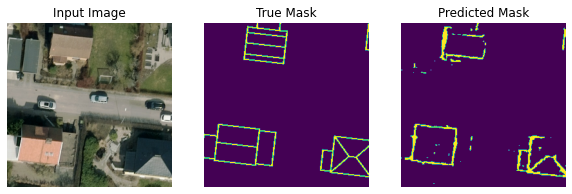

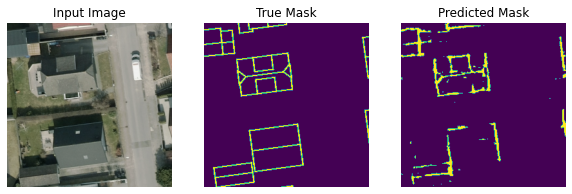

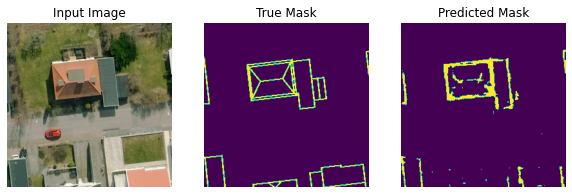

Validation MIoU: 0.5294
Epoch 42: Validation Dice_Loss : 4.2278
Epoch 42: Validation categorical_crossentropy : 0.6055
Time taken: 17.85s

Start of epoch 43
Current learning rage 0.008293
Training loss (for one batch) at step 0: 6.5253
Dice_Loss (for one batch) at step 0: 2.1433
categorical_crossentropy (for one batch) at step 0: 0.0953
Seen so far: 4 samples

Current learning rage 0.008243
Training loss (for one batch) at step 10: 5.8859
Dice_Loss (for one batch) at step 10: 1.8254
categorical_crossentropy (for one batch) at step 10: 0.4097
Seen so far: 44 samples

Current learning rage 0.008193
Training loss (for one batch) at step 20: 6.9130
Dice_Loss (for one batch) at step 20: 2.2485
categorical_crossentropy (for one batch) at step 20: 0.1674
Seen so far: 84 samples

Current learning rage 0.008142
Training loss (for one batch) at step 30: 5.9068
Dice_Loss (for one batch) at step 30: 1.8501
categorical_crossentropy (for one batch) at step 30: 0.3564
Seen so far: 124 samples

Curren

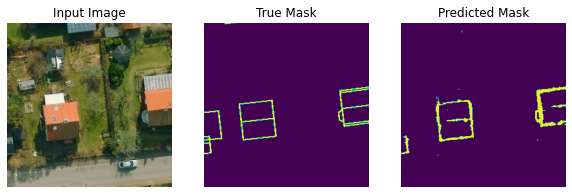

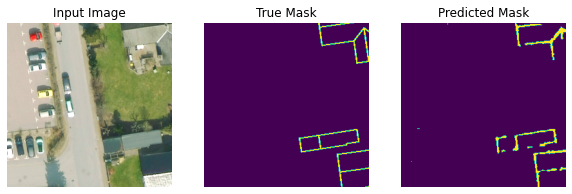

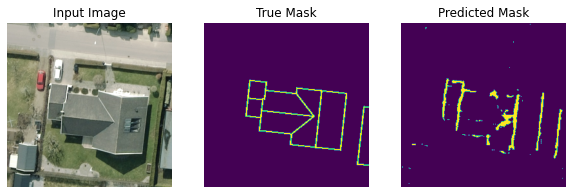

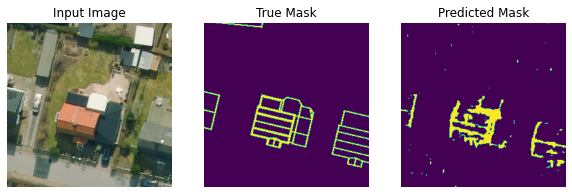

Validation MIoU: 0.5328
Epoch 43: Validation Dice_Loss : 4.1194
Epoch 43: Validation categorical_crossentropy : 0.5506
Time taken: 17.91s

Start of epoch 44
Current learning rage 0.007728
Training loss (for one batch) at step 0: 5.6662
Dice_Loss (for one batch) at step 0: 1.7945
categorical_crossentropy (for one batch) at step 0: 0.2827
Seen so far: 4 samples

Current learning rage 0.007676
Training loss (for one batch) at step 10: 6.4107
Dice_Loss (for one batch) at step 10: 2.0349
categorical_crossentropy (for one batch) at step 10: 0.3060
Seen so far: 44 samples

Current learning rage 0.007625
Training loss (for one batch) at step 20: 4.7904
Dice_Loss (for one batch) at step 20: 1.5260
categorical_crossentropy (for one batch) at step 20: 0.2124
Seen so far: 84 samples

Current learning rage 0.007573
Training loss (for one batch) at step 30: 4.8236
Dice_Loss (for one batch) at step 30: 1.5238
categorical_crossentropy (for one batch) at step 30: 0.2522
Seen so far: 124 samples

Curren

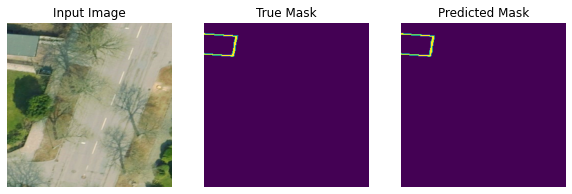

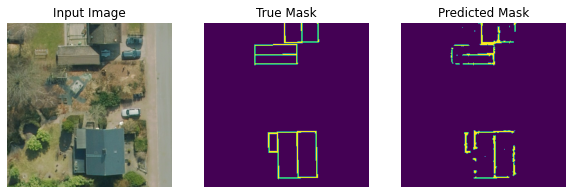

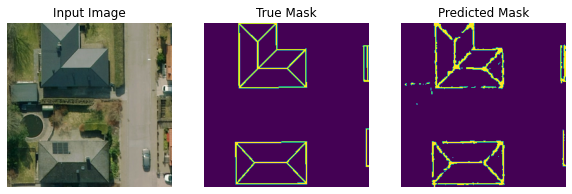

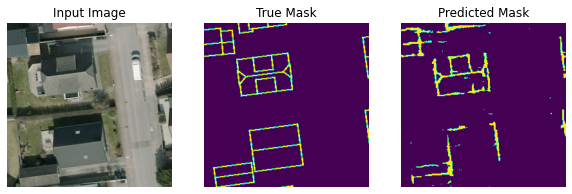

Validation MIoU: 0.5316
Epoch 44: Validation Dice_Loss : 4.1730
Epoch 44: Validation categorical_crossentropy : 0.5454
Time taken: 17.99s

Start of epoch 45
Current learning rage 0.007148
Training loss (for one batch) at step 0: 4.0950
Dice_Loss (for one batch) at step 0: 1.3180
categorical_crossentropy (for one batch) at step 0: 0.1411
Seen so far: 4 samples

Current learning rage 0.007096
Training loss (for one batch) at step 10: 5.3656
Dice_Loss (for one batch) at step 10: 1.7006
categorical_crossentropy (for one batch) at step 10: 0.2638
Seen so far: 44 samples

Current learning rage 0.007043
Training loss (for one batch) at step 20: 5.3846
Dice_Loss (for one batch) at step 20: 1.7128
categorical_crossentropy (for one batch) at step 20: 0.2463
Seen so far: 84 samples

Current learning rage 0.006990
Training loss (for one batch) at step 30: 8.5422
Dice_Loss (for one batch) at step 30: 2.7520
categorical_crossentropy (for one batch) at step 30: 0.2863
Seen so far: 124 samples

Curren

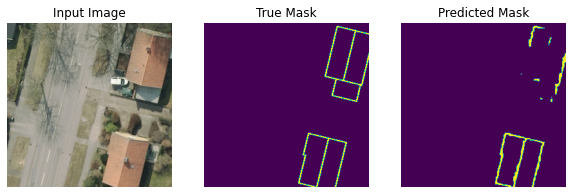

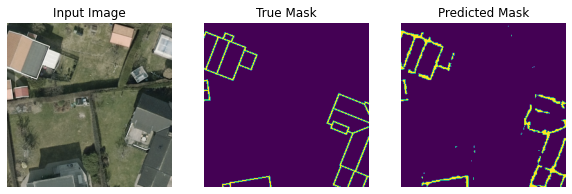

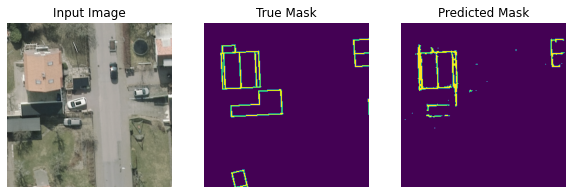

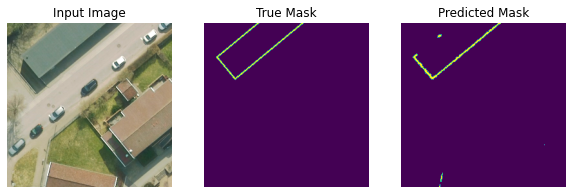

Validation MIoU: 0.5293
Epoch 45: Validation Dice_Loss : 4.2294
Epoch 45: Validation categorical_crossentropy : 0.4963
Time taken: 17.92s

Start of epoch 46
Current learning rage 0.006559
Training loss (for one batch) at step 0: 4.2018
Dice_Loss (for one batch) at step 0: 1.3462
categorical_crossentropy (for one batch) at step 0: 0.1632
Seen so far: 4 samples

Current learning rage 0.006506
Training loss (for one batch) at step 10: 3.3330
Dice_Loss (for one batch) at step 10: 1.0654
categorical_crossentropy (for one batch) at step 10: 0.1367
Seen so far: 44 samples

Current learning rage 0.006453
Training loss (for one batch) at step 20: 5.0200
Dice_Loss (for one batch) at step 20: 1.5873
categorical_crossentropy (for one batch) at step 20: 0.2581
Seen so far: 84 samples

Current learning rage 0.006399
Training loss (for one batch) at step 30: 6.5848
Dice_Loss (for one batch) at step 30: 2.1484
categorical_crossentropy (for one batch) at step 30: 0.1398
Seen so far: 124 samples

Curren

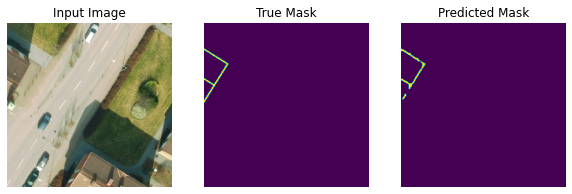

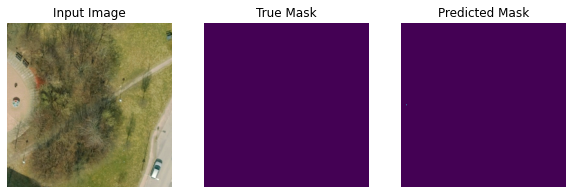

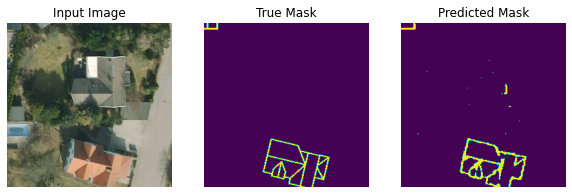

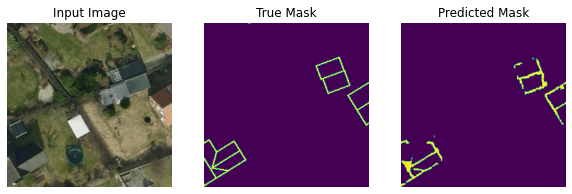

Validation MIoU: 0.5283
Epoch 46: Validation Dice_Loss : 4.2485
Epoch 46: Validation categorical_crossentropy : 0.5257
Time taken: 18.08s

Start of epoch 47
Current learning rage 0.005967
Training loss (for one batch) at step 0: 4.8841
Dice_Loss (for one batch) at step 0: 1.5618
categorical_crossentropy (for one batch) at step 0: 0.1987
Seen so far: 4 samples

Current learning rage 0.005914
Training loss (for one batch) at step 10: 6.5533
Dice_Loss (for one batch) at step 10: 2.1485
categorical_crossentropy (for one batch) at step 10: 0.1076
Seen so far: 44 samples

Current learning rage 0.005860
Training loss (for one batch) at step 20: 4.9108
Dice_Loss (for one batch) at step 20: 1.5575
categorical_crossentropy (for one batch) at step 20: 0.2382
Seen so far: 84 samples

Current learning rage 0.005807
Training loss (for one batch) at step 30: 7.8857
Dice_Loss (for one batch) at step 30: 2.5695
categorical_crossentropy (for one batch) at step 30: 0.1771
Seen so far: 124 samples

Curren

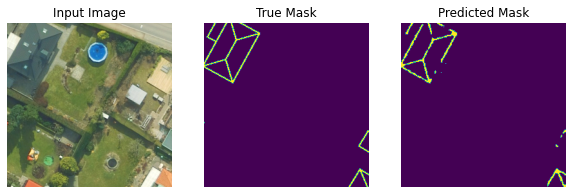

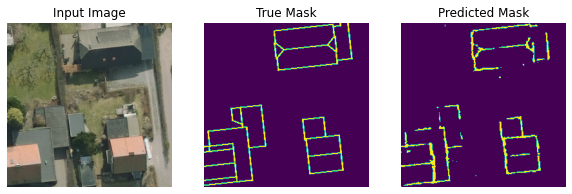

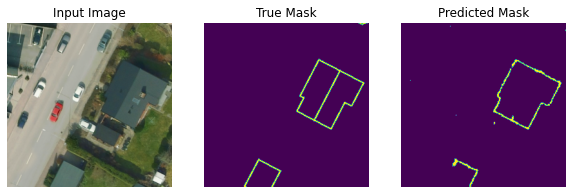

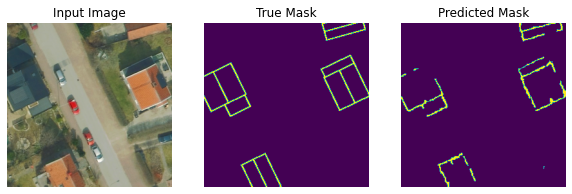

Validation MIoU: 0.5253
Epoch 47: Validation Dice_Loss : 4.3095
Epoch 47: Validation categorical_crossentropy : 0.5829
Time taken: 18.15s

Start of epoch 48
Current learning rage 0.005377
Training loss (for one batch) at step 0: 4.6701
Dice_Loss (for one batch) at step 0: 1.4827
categorical_crossentropy (for one batch) at step 0: 0.2220
Seen so far: 4 samples

Current learning rage 0.005324
Training loss (for one batch) at step 10: 6.0003
Dice_Loss (for one batch) at step 10: 1.9082
categorical_crossentropy (for one batch) at step 10: 0.2758
Seen so far: 44 samples

Current learning rage 0.005272
Training loss (for one batch) at step 20: 3.7000
Dice_Loss (for one batch) at step 20: 1.1638
categorical_crossentropy (for one batch) at step 20: 0.2087
Seen so far: 84 samples

Current learning rage 0.005219
Training loss (for one batch) at step 30: 4.9131
Dice_Loss (for one batch) at step 30: 1.5577
categorical_crossentropy (for one batch) at step 30: 0.2400
Seen so far: 124 samples

Curren

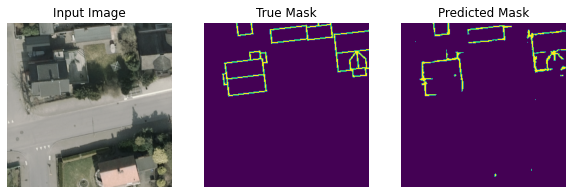

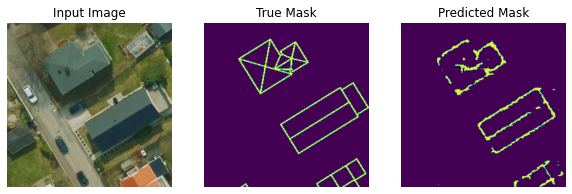

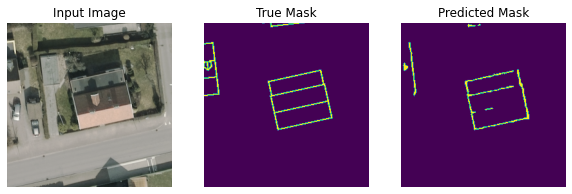

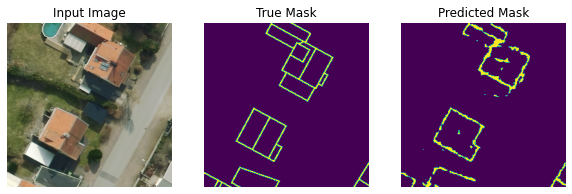

Validation MIoU: 0.5219
Epoch 48: Validation Dice_Loss : 4.3600
Epoch 48: Validation categorical_crossentropy : 0.5980
Time taken: 17.86s

Start of epoch 49
Current learning rage 0.004795
Training loss (for one batch) at step 0: 4.5821
Dice_Loss (for one batch) at step 0: 1.4599
categorical_crossentropy (for one batch) at step 0: 0.2023
Seen so far: 4 samples

Current learning rage 0.004744
Training loss (for one batch) at step 10: 4.7983
Dice_Loss (for one batch) at step 10: 1.5200
categorical_crossentropy (for one batch) at step 10: 0.2383
Seen so far: 44 samples

Current learning rage 0.004692
Training loss (for one batch) at step 20: 3.0672
Dice_Loss (for one batch) at step 20: 0.9826
categorical_crossentropy (for one batch) at step 20: 0.1194
Seen so far: 84 samples

Current learning rage 0.004640
Training loss (for one batch) at step 30: 3.9446
Dice_Loss (for one batch) at step 30: 1.2745
categorical_crossentropy (for one batch) at step 30: 0.1212
Seen so far: 124 samples

Curren

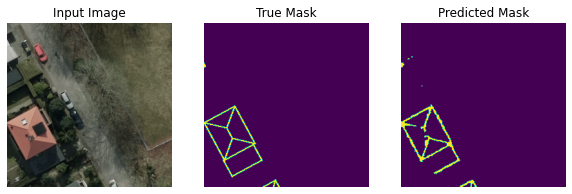

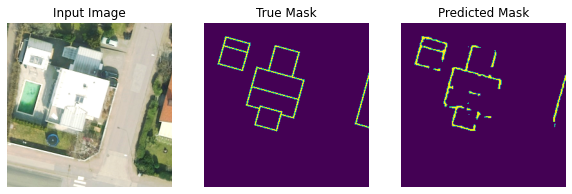

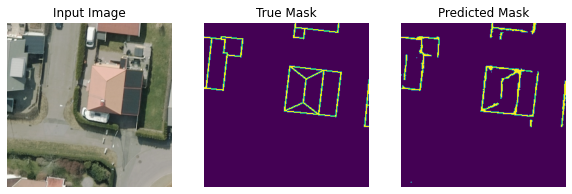

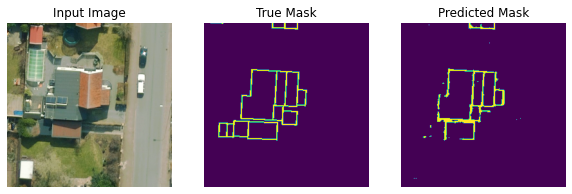

Validation MIoU: 0.5274
Epoch 49: Validation Dice_Loss : 4.2469
Epoch 49: Validation categorical_crossentropy : 0.5329
Time taken: 17.92s


In [ ]:
best_val_mIOU = 0

# Change the folder for each test
writer = tf.summary.create_file_writer(tb_folder)

epochs = 50
for epoch in range(epochs):
    print("\nStart of epoch %d" % (epoch,))
    start_time = time.time()
    losses = np.array([0., 0., 0.])
    val_losses = np.array([0., 0., 0.])
    
    # Iterate over the batches of the dataset.
    for step, (x_batch_train, y_batch_train) in enumerate(train_dataset): # for run test use train_dataset.take(4)
        
        loss_value, loss_value_1, loss_value_2, pred_masks = train_step(x_batch_train, y_batch_train)
        losses += np.array([loss_value, loss_value_1, loss_value_2])
        
        # Update training metric.
        metric_2_train.update_state(y_batch_train, pred_masks)
        
        
        
        # Get current lr and update for every 
        """?batch?"""
        current_lr = optimizer.learning_rate.numpy()
        lr = lr_scheduler(step)
        optimizer.learning_rate.assign(lr)
        
        
        
        # Log every 10 batches
        if step % 10 == 0:
            print("Current learning rage %.6f" % (current_lr))
            print(
                "Training loss (for one batch) at step %d: %.4f"
                % (step, float(loss_value))
            )
            print(
                "%s (for one batch) at step %d: %.4f"
                % (loss_fn_1.name, step, float(loss_value_1))
            )
            
            print(
                "%s (for one batch) at step %d: %.4f"
                % (loss_fn_2.name, step, float(loss_value_2))
            )
            
            print("Seen so far: %s samples" % ((step + 1) * batch_size))
            print()
            
            

    # Display metrics at the end of each epoch.
    miou_result = metric_2_train.result()
    print("Epoch %d:Training MIoU over epoch: %.4f" % (epoch, float(miou_result)))
    print("Epoch %d: Training %s : %.4f" % (epoch, loss_fn_1.name, float(losses[1] / (step + 1))))
    print("Epoch %d: Training %s : %.4f" % (epoch, loss_fn_2.name, float(losses[2] / (step + 1))))
    
    
    # Reset training metrics at the end of each epoch
    metric_2_train.reset_states()
    
    # Visualisation
#     clear_output(wait=True)
    print ('\nSample Prediction after epoch {}\n'.format(epoch+1))
    show_predictions(train_dataset) # The dataset on which we are checking 
                               # the predictions
        
    # Log Images into Tensorboard    
    with writer.as_default():
        tf.summary.image("img", x_batch_train, step=epoch)       
        tf.summary.image("true mask", y_batch_train, step=epoch)  
        
        # ToDo: Transform the pred_masks for display
        tf.summary.image("pred mask", pred_masks, step=epoch)
                                      

            
    
    # Run a validation loop at the end of each epoch.
    for step_val, (x_batch_val, y_batch_val) in enumerate(valid_dataset):
        loss_value_val, loss_value_1_val, loss_value_2_val, pred_masks_valid = valid_step(x_batch_val, y_batch_val)
        val_losses += np.array([loss_value_val, loss_value_1_val, loss_value_2_val])
        
        # Update val metrics
        metric_2_valid.update_state(y_batch_val, pred_masks_valid)
        
    miou_valid_result = metric_2_valid.result()
    metric_2_valid.reset_states()
 
    print("Validation MIoU: %.4f" % (float(miou_valid_result),))
    print("Epoch %d: Validation %s : %.4f" % (epoch, loss_fn_1.name, float(val_losses[1] / (step_val + 1))))
    print("Epoch %d: Validation %s : %.4f" % (epoch, loss_fn_2.name, float(val_losses[2] / (step_val + 1))))
    
    
    
    # Log to Tensorboard
    
    with writer.as_default():
        # Training scalars
        tf.summary.scalar('Training MIoU', miou_result, step=epoch)
        tf.summary.scalar('Training loss_1', float(losses[1] / (step + 1)), step=epoch)
        tf.summary.scalar('Training loss_2', float(losses[2] / (step + 1)), step=epoch)
        # Validation scalars
        tf.summary.scalar('Validation MIoU', miou_valid_result, step=epoch)
        tf.summary.scalar('Validation loss_1', float(val_losses[1] / (step_val + 1)), step=epoch)
        tf.summary.scalar('Validation loss_2', float(val_losses[2] / (step_val + 1)), step=epoch)
    writer.flush()
    
    
    # Save_best_model:
    # if miou_valid_result > best_val_mIOU:
    #     model_path = model_path
    #     model.save(model_path)
    #     print('Model improved and saved')
 
    print("Time taken: %.2fs" % (time.time() - start_time))

In [ ]:
# !mv "simple_logs" "/content/drive/MyDrive/Colab Notebooks/Rooftop_segmentation/copied_log"

# Output Test

In [ ]:
"""The output are BS masks"""
for image, mask in train_dataset.take(1):
    image, mask, 
    pred_mask = model.predict(image)
#     for i in range(pred_mask.shape[0]):
#         display([image[i], mask[i], create_mask(pred_mask[i], from_logits=True)])

In [ ]:
print(mask.shape)
print(pred_mask.shape)

(4, 256, 256, 1)
(4, 256, 256, 2)


# CONFUSION MATRIX

In [ ]:
# MIoU
def mio_test(gt_mask, pred_mask):
    eps = 1e-8
    label = tf.argmax(pred_mask, axis=-1)

    gt_image = tf.squeeze(gt_mask, -1)
    mask_cm = (gt_image >= 0) & (gt_image < num_classes)

    label = num_classes * tf.cast(gt_image[mask_cm], tf.int8) + tf.cast(label[mask_cm], tf.int8)
    count = np.bincount(label, minlength=num_classes ** 2)

    confusion_matrix = count.reshape(num_classes, num_classes)
    
    MIoU = np.diag(confusion_matrix) / (np.sum(confusion_matrix, axis=1) + np.sum(confusion_matrix, axis=0) - (np.diag(confusion_matrix) + eps))
    MIoU = np.nanmean(MIoU)

    return MIoU

In [ ]:
pred_2 = pred_mask[:,55:60,20:25,:]
gt_2 = mask[:,55:60,20:25,:]

miou = mio_test(gt_2, pred_2)
miou

# Others

## TensorBoard.dev: Host and share your ML experiment results

[TensorBoard.dev](https://tensorboard.dev) is a free public service that enables you to upload your TensorBoard logs and get a permalink that can be shared with everyone in academic papers, blog posts, social media, etc.  This can enable better reproducibility and collaboration.

To use TensorBoard.dev, run the following command:

In [ ]:
# !tensorboard dev upload \
#   --logdir "/content/drive/MyDrive/Colab Notebooks/Rooftop_segmentation/copied_log" \
#   --name "RoofTop Segmentation" \
#   --description "(optional)" \
#   --one_shot

## For more details on how to use TensorBoard.dev, see https://tensorboard.dev/#get-started

2021-05-19 09:21:22.596505: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0

***** TensorBoard Uploader *****

This will upload your TensorBoard logs to https://tensorboard.dev/ from
the following directory:

/content/drive/MyDrive/Colab Notebooks/Rooftop_segmentation/copied_log

This TensorBoard will be visible to everyone. Do not upload sensitive
data.

Your use of this service is subject to Google's Terms of Service
<https://policies.google.com/terms> and Privacy Policy
<https://policies.google.com/privacy>, and TensorBoard.dev's Terms of Service
<https://tensorboard.dev/policy/terms/>.

This notice will not be shown again while you are logged into the uploader.
To log out, run `tensorboard dev auth revoke`.

Continue? (yes/NO) yes

Please visit this URL to authorize this application: https://accounts.google.com/o/oauth2/auth?response_type=code&client_id=373649185512-8v619h5kft38l4456nm2dj4ubeqsrvh6.apps.googleuse